In [5]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
import math
import random
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
import gym

In [86]:
%pwd

'/Users/alanyang/Desktop/579 RL/Reinforcement-Learning-Project'

In [14]:
def save_rewards_data(rewards_data, filename='rewards_data.pkl'):
    """Save the rewards data to a pickle file."""
    with open(filename, 'wb') as file:
        pickle.dump(rewards_data, file)
    print(f'Rewards data saved to {filename}')

def load_rewards_data(filename='rewards_data.pkl'):
    """Load the rewards data from a pickle file."""
    try:
        with open(filename, 'rb') as file:
            rewards_data = pickle.load(file)
        print(f'Rewards data loaded from {filename}')
        return rewards_data
    except FileNotFoundError:
        print(f'Error: The file {filename} does not exist. Please check the file path and try again.')
        return None
    except Exception as e:
        print(f'An error occurred while loading the data: {e}')
        return None


def reverse_keys(tc_data):
    """
    Reverse the keys of the tc_data dictionary.
    
    :param tc_data: Original dictionary with structure {alpha: {epsilon: data}}
    :return: New dictionary with structure {epsilon: {alpha: data}}
    """
    new_data = {}
    for alpha, epsilons in tc_data.items():
        for epsilon, data in epsilons.items():
            if epsilon not in new_data:
                new_data[epsilon] = {}
            new_data[epsilon][alpha] = data
    return new_data


def get_data_with_metadata(original_data, alpha, epsilon, algorithm_name):
    try:
        # Attempt to directly retrieve the data
        data = original_data[epsilon][alpha]
    except KeyError:
        # Return None if the specified alpha or epsilon does not exist
        data = None

    return {
        "algorithm_name": algorithm_name,
        "epsilon": epsilon,
        "alpha": alpha,
        "data": data
    }

def get_data_with_metadata_gae(original_data, alpha, gamma, tau, algorithm_name):
    return {
        "algorithm_name": algorithm_name,
        "gamma": gamma,
        "tau": tau,
        "alpha": alpha,
        "data": original_data['PPO_GAE']
    }

def get_data_with_metadata_ppogae(original_data, alpha, gamma, tau, algorithm_name):
    return {
        "algorithm_name": algorithm_name,
        "gamma": gamma,
        "tau": tau,
        "alpha": alpha,
        "data": [original_data]
    }

def plot_rewards(rewards_data, algorithm_name="Expected SARSA", dec="TC", env="CartPole"):
    """Plot the average performance and IQR of the policy."""
    plt.figure(figsize=(14, 7))

    for epsilon, alphas in rewards_data.items():
        for alpha, data in alphas.items():
            # Calculate average and IQR across runs for each episode
            data = np.array(data)  # Convert to numpy array for easier slicing
            avg_rewards = np.mean(data, axis=0)
            lower_quartile = np.percentile(data, 25, axis=0)
            upper_quartile = np.percentile(data, 75, axis=0)

            episodes = np.arange(len(avg_rewards)) + 1
            if epsilon == 'N/A':
                plt.plot(episodes, avg_rewards, label=f'α={alpha}')
            else:
                plt.plot(episodes, avg_rewards, label=f'ε={epsilon}, α={alpha}')
            plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)

    plt.title(f'Average Performance and IQR by Epsilon and Alpha ({algorithm_name} ({dec}) in {env})')
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.legend()
    plt.show()

def plot_rewards_v2(rewards_data, algorithm_name="Expected SARSA", dec="TC", env="CartPole", legend_position='upper left', size=24):
    plt.rcParams['axes.labelsize'] = size  # Sets the font size for the x and y labels
    plt.rcParams['axes.titlesize'] = size  # Sets the font size for the title
    plt.rcParams['xtick.labelsize'] = size # Sets the font size for the x-axis tick labels
    plt.rcParams['ytick.labelsize'] = size # Sets the font size for the y-axis tick labels
    plt.rcParams['legend.fontsize'] = size # Sets the font size for the legend

    plt.figure(figsize=(20, 10))

    for epsilon, alphas in rewards_data.items():
        for alpha, data in alphas.items():
            data = np.array(data)
            avg_rewards = np.mean(data, axis=0)
            lower_quartile = np.percentile(data, 25, axis=0)
            upper_quartile = np.percentile(data, 75, axis=0)

            episodes = np.arange(len(avg_rewards)) + 1
            plt.plot(episodes, avg_rewards, label=f'ε={epsilon}, α={alpha}')
            plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)

    plt.title(f'Average Performance and IQR by Epsilon and Alpha ({algorithm_name} ({dec}) in {env})')
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.legend(loc=legend_position)
    plt.show()



def convert_trpo_data(trpo_data, alpha, epsilon):
    runs = trpo_data["TRPO"]
    result = {}
    result[epsilon] = {}
    result[epsilon][alpha] = runs
    return result

def calculate_cumulative_rewards(data_list):
    result_list = []

    for entry in data_list:
        algorithm_name = entry["algorithm_name"]
        alpha = entry["alpha"]
        epsilon = entry["epsilon"]
        episode_rewards = entry["data"]

        if episode_rewards is None or len(episode_rewards) == 0:
            cumulative_rewards = None
        else:
            # Convert to numpy array for easier mathematical operations
            data = np.array(episode_rewards)
            # Calculate the average rewards across all runs for each episode
            avg_rewards = np.mean(data, axis=0)
            # Calculate the cumulative sum of the average rewards
            cumulative_rewards = np.sum(avg_rewards)

        # Append the calculated data to the result list
        result_list.append({
            "algorithm_name": algorithm_name,
            "alpha": alpha,
            "epsilon": epsilon,
            "cumulative_rewards": cumulative_rewards.tolist() if cumulative_rewards is not None else None
        })

    return result_list


def calculate_overall_metrics(data_list):
    result_list = []

    for entry in data_list:
        if "tau" in entry.keys():
            algorithm_name = entry["algorithm_name"]
            gamma = entry["gamma"]
            tau = entry["tau"]
            alpha = entry["alpha"]
            episode_rewards = np.array(entry["data"])

            # Cumulative Rewards
            data = np.array(episode_rewards)
            avg_rewards = np.mean(data, axis=0)
            cumulative_rewards = np.sum(avg_rewards)

            # Average Rewards and Std Error
            all_episode_returns = [episode_return for run in episode_rewards for episode_return in run]
            overall_average = np.mean(all_episode_returns)
            overall_std_error = np.std(all_episode_returns) / np.sqrt(len(all_episode_returns))

            # cumulative_rewards = np.sum(data)
            # overall_average = np.mean(data)
            # Append the calculated data to the result list
            result_list.append({
                "algorithm_name": algorithm_name,
                "alpha": alpha,
                "gamma": gamma,
                "tau": tau,
                "cumulative_rewards": cumulative_rewards if cumulative_rewards is not None else None,
                "overall_average": overall_average if overall_average is not None else None,
                "overall_std_error": overall_std_error if overall_std_error is not None else None
            })
            
        else:
            
            algorithm_name = entry["algorithm_name"]
            alpha = entry["alpha"]
            epsilon = entry["epsilon"]
            episode_rewards = entry["data"]
    
            if episode_rewards is None or len(episode_rewards) == 0:
                cumulative_rewards = None
                overall_average = None
                overall_std_error = None
                
            else:
                # Cumulative Rewards
                data = np.array(episode_rewards)
                avg_rewards = np.mean(data, axis=0)
                cumulative_rewards = np.sum(avg_rewards)
                
                # Average Rewards and Std Error
                all_episode_returns = [episode_return for run in episode_rewards for episode_return in run]
                overall_average = np.mean(all_episode_returns)
                overall_std_error = np.std(all_episode_returns) / np.sqrt(len(all_episode_returns))
    
            # Append the calculated data to the result list
            result_list.append({
                "algorithm_name": algorithm_name,
                "alpha": alpha,
                "epsilon": epsilon,
                "cumulative_rewards": cumulative_rewards if cumulative_rewards is not None else None,
                "overall_average": overall_average if overall_average is not None else None,
                "overall_std_error": overall_std_error if overall_std_error is not None else None
            })
        
    return result_list


def plot_ppo_plot_v2(configs, title, tau, gamma, size=24):
    plt.rcParams['axes.labelsize'] = size  # Sets the font size for the x and y labels
    plt.rcParams['axes.titlesize'] = size  # Sets the font size for the title
    plt.rcParams['xtick.labelsize'] = size # Sets the font size for the x-axis tick labels
    plt.rcParams['ytick.labelsize'] = size # Sets the font size for the y-axis tick labels
    plt.rcParams['legend.fontsize'] = size # Sets the font size for the legend
    plt.figure(figsize=(20, 10))

    data = configs['PPO_GAE']
    data = np.array(data)
    avg_rewards = np.mean(data, axis=0)
    lower_quartile = np.percentile(data, 25, axis=0)
    upper_quartile = np.percentile(data, 75, axis=0)

    episodes = np.arange(len(avg_rewards)) + 1
    plt.plot(episodes, avg_rewards, label=f'tau={tau}, gamma={gamma}')
    plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)
    plt.title(title)
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.show()

def plot_gae_plot(configs, title):
    plt.figure(figsize=(14, 7))

    for config in configs:
        mean_rewards = load_rewards_data(config['file'])
        plt.plot(mean_rewards, label=f'ppo learning rate={config["lr_policy"]}, gamma={config["gamma"]}, gae_lambda={config["gae_lambda"]}')

    plt.title(title)
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.legend()
    plt.show()


def plot_gae_plot_v2(configs, title, legend_position='upper left', size=24):
    plt.rcParams['axes.labelsize'] = size  # Sets the font size for the x and y labels
    plt.rcParams['axes.titlesize'] = size  # Sets the font size for the title
    plt.rcParams['xtick.labelsize'] = size # Sets the font size for the x-axis tick labels
    plt.rcParams['ytick.labelsize'] = size # Sets the font size for the y-axis tick labels
    plt.rcParams['legend.fontsize'] = size # Sets the font size for the legend

    plt.figure(figsize=(20, 10))

    for config in configs:
        mean_rewards = load_rewards_data(config['file'])
        plt.plot(mean_rewards, label=f'ppo learning rate={config["lr_policy"]}, gamma={config["gamma"]}, gae_lambda={config["gae_lambda"]}')

    plt.title(title)
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.legend(loc=legend_position)
    plt.show()
    

def plot_summary_performances(summary_data, title='Best Performance and IQR by Algorithm, Epsilon, and Alpha'):
    """
    Plot the average performance and IQR for the best data from different algorithms, 
    epsilon, and alpha.
    
    :param summary_data: A list of dictionaries, each containing algorithm name, 
                         epsilon, alpha, and data. The data should be in a format 
                         where each row represents a run, and each column an episode.
    """
    plt.figure(figsize=(14, 7))

    for entry in summary_data:
        if "tau" in entry.keys():
            algorithm_name = entry["algorithm_name"]
            gamma = entry["gamma"]
            tau = entry["tau"]
            alpha = entry["alpha"]
            data = np.array(entry["data"])

            if data.size > 0:  # Ensure there is data to process
                avg_rewards = np.mean(data, axis=0)
                lower_quartile = np.percentile(data, 25, axis=0)
                upper_quartile = np.percentile(data, 75, axis=0)

                episodes = np.arange(len(data)) + 1
                plt.plot(episodes, avg_rewards, label=f'{algorithm_name}: α={alpha}, gamma={gamma}, tau={tau}')
                plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)
            
        else:    
            algorithm_name = entry["algorithm_name"]
            epsilon = entry["epsilon"]
            alpha = entry["alpha"]
            data = np.array(entry["data"])  # Convert to numpy array for easier slicing
    
            if data.size > 0:  # Ensure there is data to process
                avg_rewards = np.mean(data, axis=0)
                lower_quartile = np.percentile(data, 25, axis=0)
                upper_quartile = np.percentile(data, 75, axis=0)
    
                episodes = np.arange(len(avg_rewards)) + 1
                if epsilon == 'N/A':
                    plt.plot(episodes, avg_rewards, label=f'{algorithm_name}: α={alpha}')
                else:
                    plt.plot(episodes, avg_rewards, label=f'{algorithm_name}: ε={epsilon}, α={alpha}')
                plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)

    plt.title(title)
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.legend()
    plt.show()


def plot_summary_performances_v2(summary_data, title='Best Performance and IQR by Algorithm, Epsilon, and Alpha', legend_position='upper left', size=24):
    """
    Plot the average performance and IQR for the best data from different algorithms,
    epsilon, and alpha.

    :param summary_data: A list of dictionaries, each containing algorithm name,
                         epsilon, alpha, and data. The data should be in a format
                         where each row represents a run, and each column an episode.
    """
    plt.rcParams['axes.labelsize'] = size  # Sets the font size for the x and y labels
    plt.rcParams['axes.titlesize'] = size  # Sets the font size for the title
    plt.rcParams['xtick.labelsize'] = size # Sets the font size for the x-axis tick labels
    plt.rcParams['ytick.labelsize'] = size # Sets the font size for the y-axis tick labels
    plt.rcParams['legend.fontsize'] = size # Sets the font size for the legend

    plt.figure(figsize=(20, 10))

    for entry in summary_data:
        if "tau" in entry.keys():
            algorithm_name = entry["algorithm_name"]
            gamma = entry["gamma"]
            tau = entry["tau"]
            alpha = entry["alpha"]
            data = np.array(entry["data"])

            if data.size > 0:  # Ensure there is data to process
                avg_rewards = np.mean(data, axis=0)
                lower_quartile = np.percentile(data, 25, axis=0)
                upper_quartile = np.percentile(data, 75, axis=0)

                episodes = np.arange(len(avg_rewards)) + 1
                plt.plot(episodes, avg_rewards, label=f'{algorithm_name}: α={alpha}, gamma={gamma}, tau={tau}')
                plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)

        else:
            algorithm_name = entry["algorithm_name"]
            epsilon = entry["epsilon"]
            alpha = entry["alpha"]
            data = np.array(entry["data"])  # Convert to numpy array for easier slicing

            if data.size > 0:  # Ensure there is data to process
                avg_rewards = np.mean(data, axis=0)
                lower_quartile = np.percentile(data, 25, axis=0)
                upper_quartile = np.percentile(data, 75, axis=0)

                episodes = np.arange(len(avg_rewards)) + 1
                if epsilon == 'N/A':
                    plt.plot(episodes, avg_rewards, label=f'{algorithm_name}: α={alpha}')
                else:
                    plt.plot(episodes, avg_rewards, label=f'{algorithm_name}: ε={epsilon}, α={alpha}')
                plt.fill_between(episodes, lower_quartile, upper_quartile, alpha=0.25)

    plt.title(title)
    plt.xlabel('Episodes')
    plt.ylabel('Average Reward')
    plt.legend(loc=legend_position)
    plt.show()


def trim_rewards(rewards_data, episodes=500):
    # Trim each rewards list to the first 'episodes' entries
    for epsilon, alphas in rewards_data.items():
        for alpha, rewards_lists in alphas.items():
            trimmed_rewards_lists = [rewards_list[:episodes] for rewards_list in rewards_lists]
            rewards_data[epsilon][alpha] = trimmed_rewards_lists
            
    return rewards_data

def trim_rewards_gae(lst, n):
    return lst[:n]

def trim_rewards_ppo(data, new_length, key='PPO_GAE'):
    """
    Trims each sublist under a specific key in the given dictionary to the specified length.

    Parameters:
        data (dict): The dictionary containing the list of lists to be trimmed.
        key (str): The key in the dictionary where the list of lists is stored.
        new_length (int): The number of elements to keep in each sublist.

    Returns:
        dict: The modified dictionary with trimmed sublists.
    """
    if key in data:
        # Trim each sublist to the first new_length elements
        trimmed_sublists = [sublist[:new_length] for sublist in data[key]]
        # Update the dictionary with the trimmed lists
        data[key] = trimmed_sublists
    else:
        raise KeyError(f"The key '{key}' is not in the dictionary.")
    return data

def rename_key(d, old_key, new_key):
    if isinstance(d, dict):
        if old_key in d:
            d[new_key] = d.pop(old_key)  # Rename the key if found
        for key in list(d.keys()):  # Recursively call for nested dictionaries
            d[key] = rename_key(d[key], old_key, new_key)
    elif isinstance(d, list):
        for i, item in enumerate(d):  # Iterate through the list if the value is a list
            d[i] = rename_key(item, old_key, new_key)
    return d


## CarPole Expected SARSA

In [194]:
rbf_data = trim_rewards(load_rewards_data("Expected_SARSA_RBF/Expected_SARSA_RBF_CartPole"))
tc_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_TC/CP/Results_ES_CP_TC_.pkl")))
four_data = reverse_keys(load_rewards_data("Expected_SARSA_Fourier/CP/Results_ES_CP_.pkl"))


Rewards data loaded from Expected_SARSA_RBF/Expected_SARSA_RBF_CartPole
Rewards data loaded from Expected_SARSA_TC/CP/Results_ES_CP_TC_.pkl
Rewards data loaded from Expected_SARSA_Fourier/CP/Results_ES_CP_.pkl


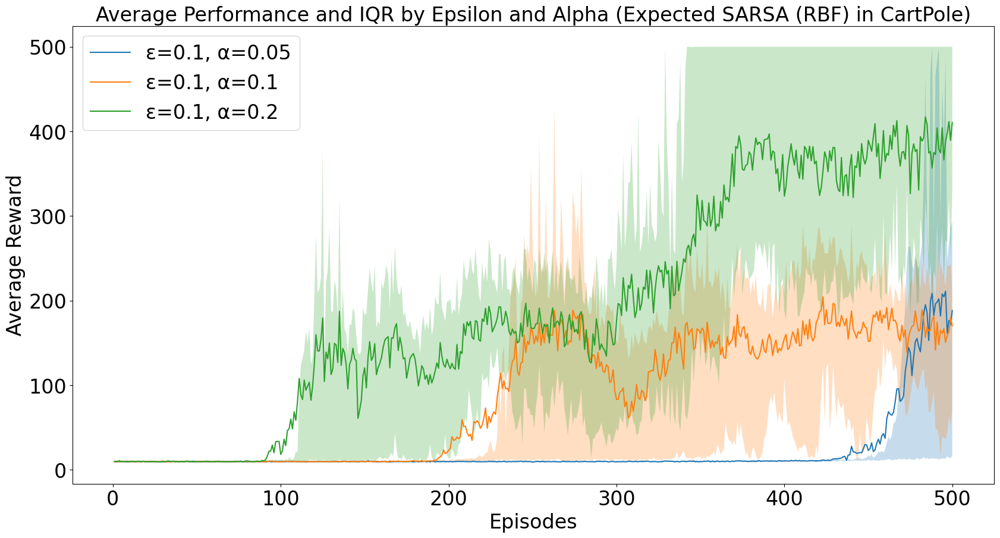

In [196]:
# RBF
plot_rewards_v2(rbf_data, algorithm_name="Expected SARSA", dec="RBF", env="CartPole")

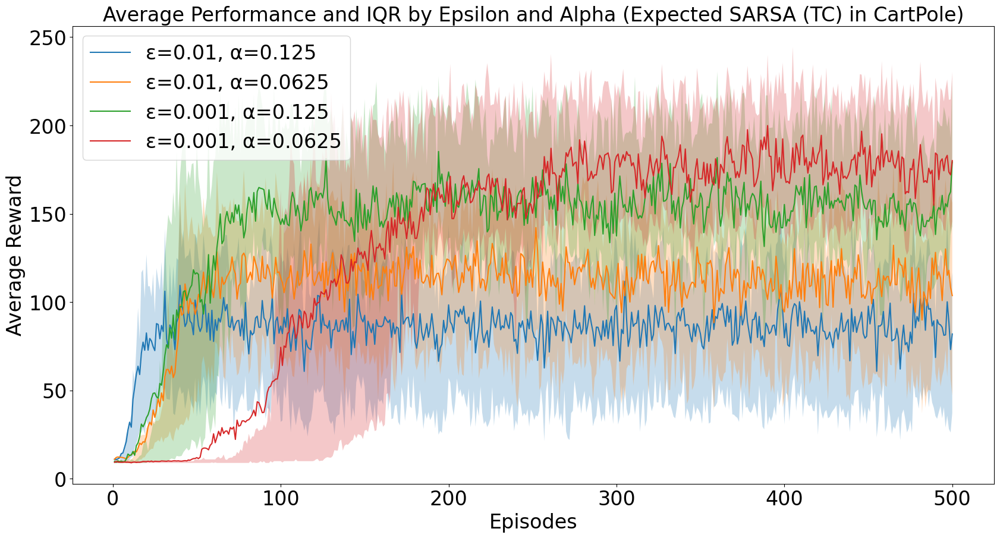

In [197]:
# TC
plot_rewards_v2(tc_data, algorithm_name="Expected SARSA", dec="TC", env="CartPole")

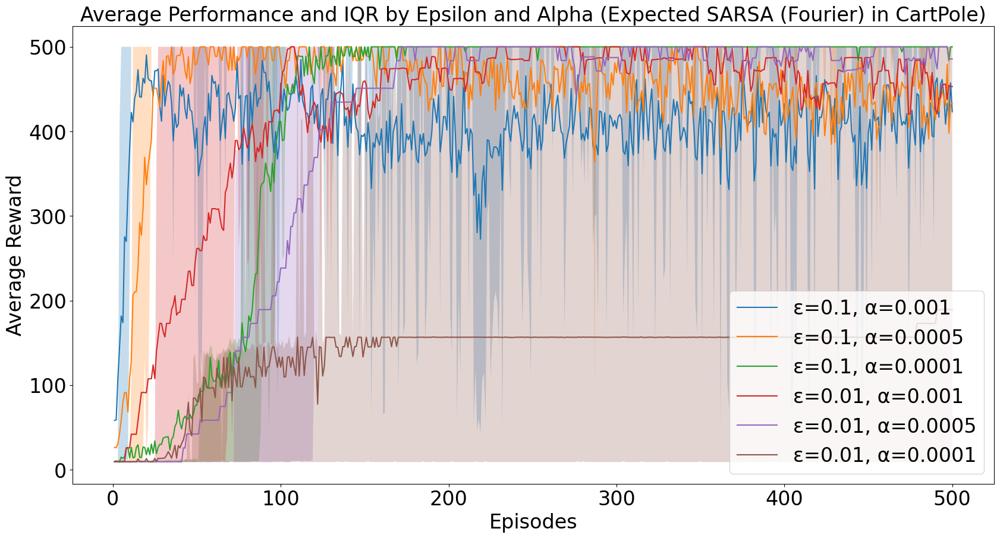

In [198]:
# Fourier
plot_rewards_v2(four_data, algorithm_name="Expected SARSA", dec="Fourier", env="CartPole", legend_position='lower right')

In [199]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.2, epsilon=0.1, algorithm_name="Expected SARSA (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0625, epsilon=0.001, algorithm_name="Expected SARSA (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.0001, epsilon=0.1, algorithm_name="Expected SARSA (Fourier Basis)")

summary = [
    best_rbf,
    best_tc,
    best_four
]

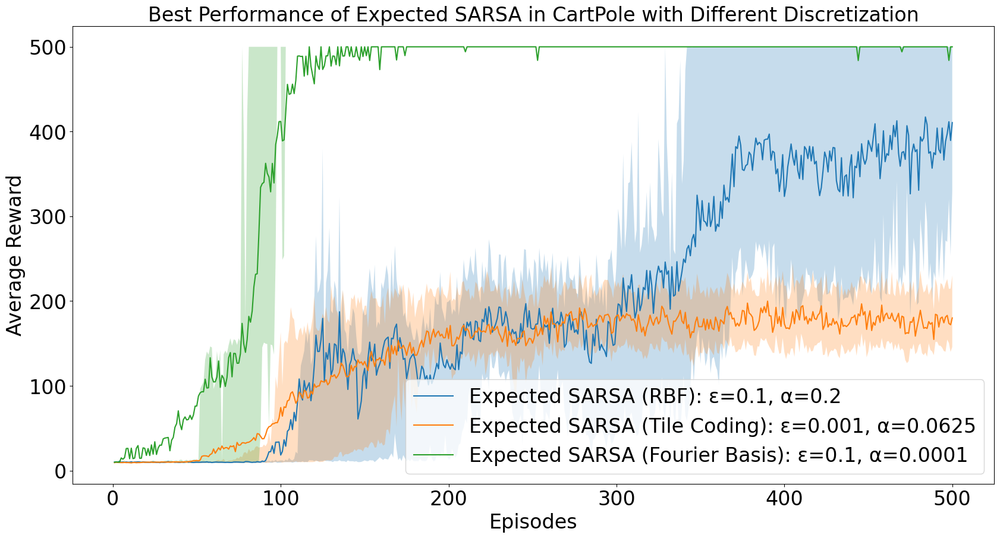

In [201]:
plot_summary_performances_v2(summary, title='Best Performance of Expected SARSA in CartPole with Different Discretization', legend_position='lower right')

In [91]:
# save Expected SARSA summary
save_rewards_data(summary, "CartPole_ES_Summary")

Rewards data saved to CartPole_ES_Summary


## CarPole DDQN

In [202]:
rbf_data = load_rewards_data("DDQN_RBF/DDQN_RBF_CP_combined.pkl")
tc_data = trim_rewards(load_rewards_data("DDQN_TC_Cheryl/DDQN_TC_CP.pkl"), episodes=200)
four_data = trim_rewards(load_rewards_data("DDQN_Fourier/DDQN_Fourier_CP.pkl"), episodes=200)

Rewards data loaded from DDQN_RBF/DDQN_RBF_CP_combined.pkl
Rewards data loaded from DDQN_TC_Cheryl/DDQN_TC_CP.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_CP.pkl


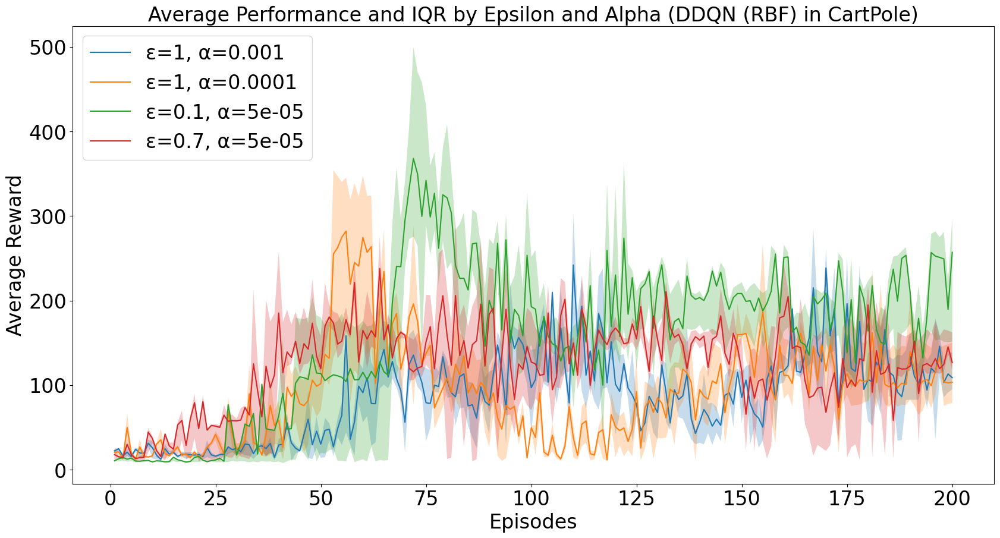

In [203]:
# RBF
plot_rewards_v2(rbf_data, algorithm_name="DDQN", dec="RBF", env="CartPole")

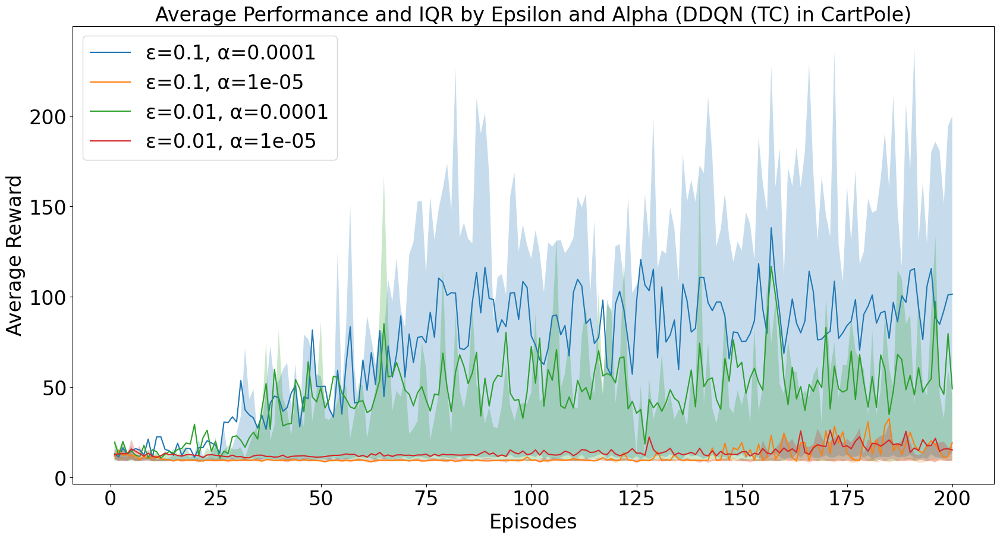

In [204]:
# TC
plot_rewards_v2(tc_data, algorithm_name="DDQN", dec="TC", env="CartPole")

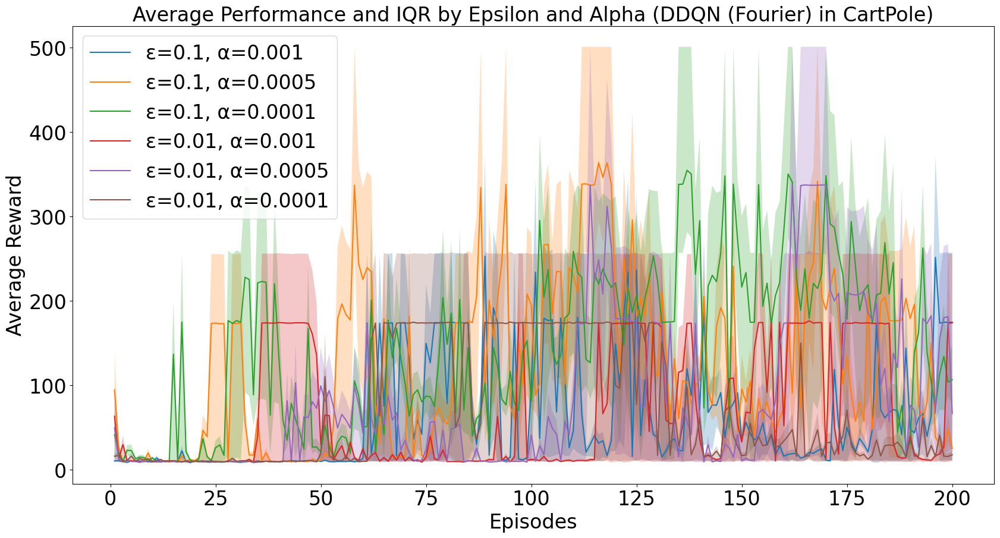

In [205]:
# Fourier
plot_rewards_v2(four_data, algorithm_name="DDQN", dec="Fourier", env="CartPole")

In [206]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=5e-05, epsilon=0.1, algorithm_name="DDQN (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0001, epsilon=0.01, algorithm_name="DDQN (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.0005, epsilon=0.1, algorithm_name="DDQN (Fourier Basis)")

summary = [
    best_rbf,
    best_tc,
    best_four
]

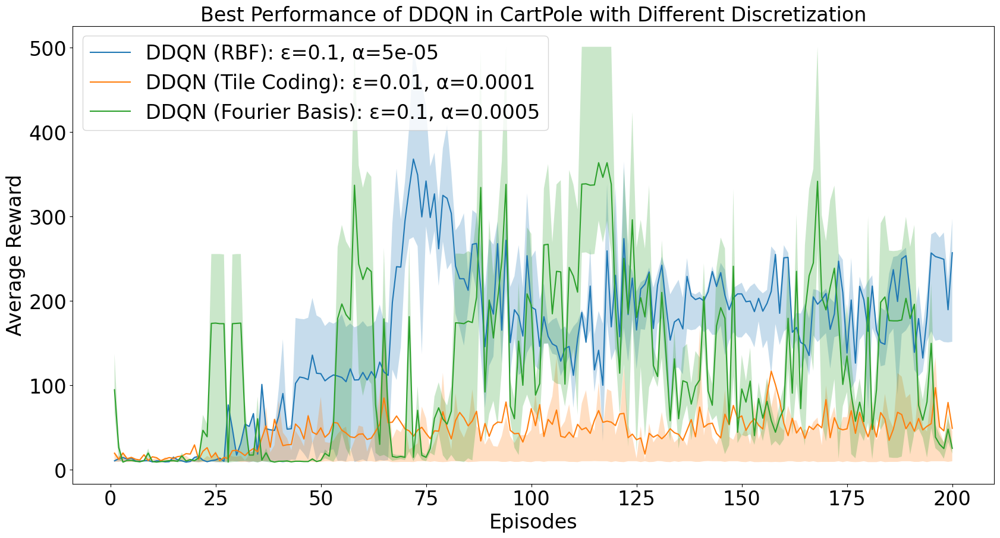

In [208]:
plot_summary_performances_v2(summary, title='Best Performance of DDQN in CartPole with Different Discretization', legend_position='upper left')

In [103]:
# save Expected SARSA summary
save_rewards_data(summary, "CartPole_DDQN_Summary")

Rewards data saved to CartPole_DDQN_Summary


## CarPole TRPO

In [209]:
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_CP.pkl"), alpha=0.01, epsilon="N/A")

Rewards data loaded from TRPO/Results_TRPO_CP.pkl


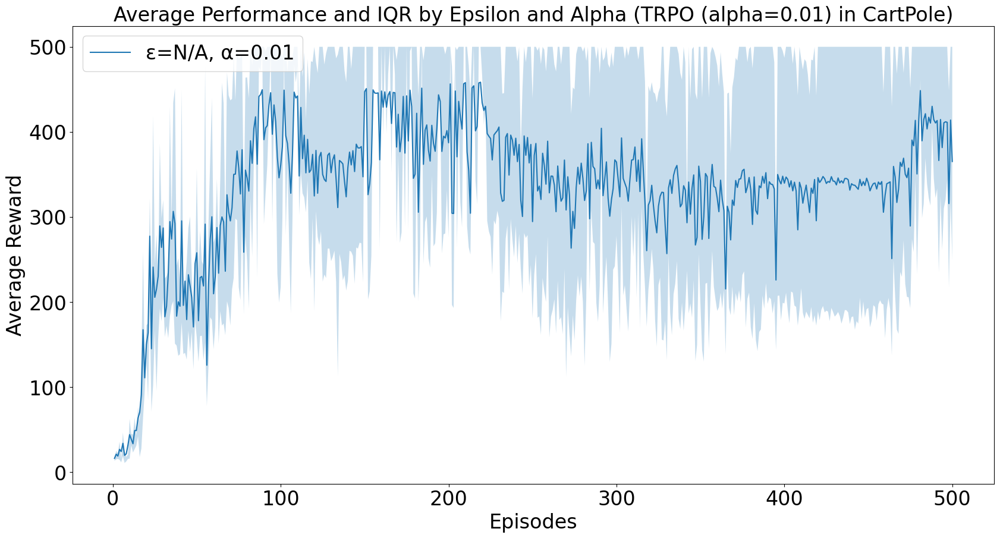

In [210]:
plot_rewards_v2(trpo_data, algorithm_name="TRPO", dec="alpha=0.01", env="CartPole")

## CarPole PPO+GAE

In [279]:
ppo_data = load_rewards_data("PPOGAE/Results_PPO+GAE_CP.pkl")

Rewards data loaded from PPOGAE/Results_PPO+GAE_CP.pkl


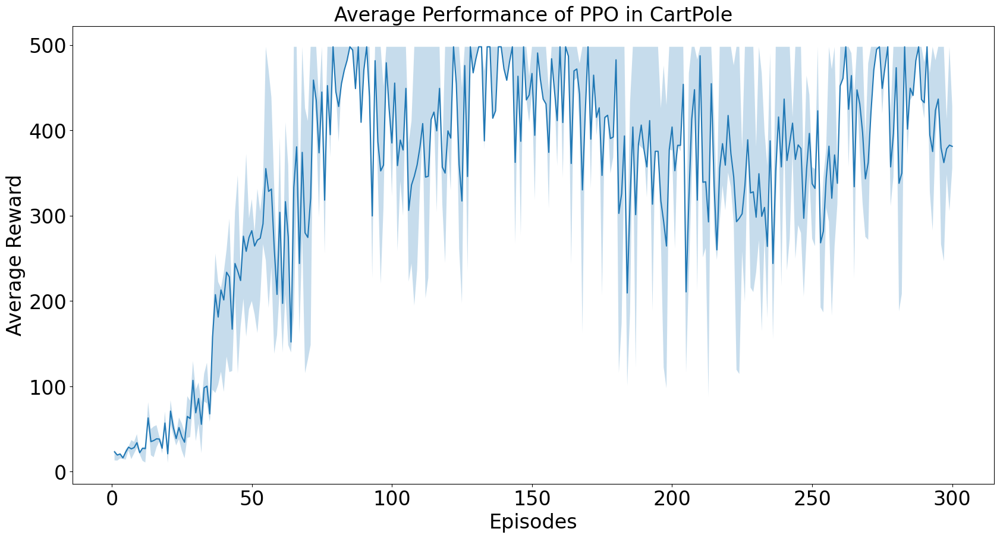

In [280]:
plot_ppo_plot_v2(configs=ppo_data, title="Average Performance of PPO in CartPole", tau=0.95, gamma=0.9)

## CarPole Combined


In [300]:
rbf_data = trim_rewards(load_rewards_data("Expected_SARSA_RBF/Expected_SARSA_RBF_CartPole"), episodes=200)
tc_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_TC/CP/Results_ES_CP_TC_.pkl")), episodes=200)
four_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_Fourier/CP/Results_ES_CP_.pkl")), episodes=200)
rbf_data_d = load_rewards_data("DDQN_RBF/DDQN_RBF_CP_combined.pkl")
tc_data_d = trim_rewards(load_rewards_data("DDQN_TC_Cheryl/DDQN_TC_CP.pkl"), episodes=200)
four_data_d = trim_rewards(load_rewards_data("DDQN_Fourier/DDQN_Fourier_CP.pkl"), episodes=200)
trpo_data = trim_rewards(convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_CP.pkl"), alpha=0.01, epsilon="N/A"), episodes=200)
ppo_data = trim_rewards_ppo(load_rewards_data("PPOGAE/Results_PPO+GAE_CP.pkl"), new_length=200)

Rewards data loaded from Expected_SARSA_RBF/Expected_SARSA_RBF_CartPole
Rewards data loaded from Expected_SARSA_TC/CP/Results_ES_CP_TC_.pkl
Rewards data loaded from Expected_SARSA_Fourier/CP/Results_ES_CP_.pkl
Rewards data loaded from DDQN_RBF/DDQN_RBF_CP_combined.pkl
Rewards data loaded from DDQN_TC_Cheryl/DDQN_TC_CP.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_CP.pkl
Rewards data loaded from TRPO/Results_TRPO_CP.pkl
Rewards data loaded from PPOGAE/Results_PPO+GAE_CP.pkl


In [301]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.2, epsilon=0.1, algorithm_name="Expected SARSA (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0625, epsilon=0.001, algorithm_name="Expected SARSA (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.0001, epsilon=0.1, algorithm_name="Expected SARSA (Fourier Basis)")
best_rbf_d = get_data_with_metadata(original_data=rbf_data_d, alpha=5e-05, epsilon=0.1, algorithm_name="DDQN (RBF)")
best_tc_d = get_data_with_metadata(original_data=tc_data_d, alpha=0.0001, epsilon=0.01, algorithm_name="DDQN (Tile Coding)")
best_four_d = get_data_with_metadata(original_data=four_data_d, alpha=0.0005, epsilon=0.1, algorithm_name="DDQN (Fourier Basis)")
best_trpo = get_data_with_metadata(original_data=trpo_data, alpha=0.01, epsilon='N/A', algorithm_name="TRPO")
best_ppo = get_data_with_metadata_gae(original_data=ppo_data, alpha=0.0001, gamma=0.9, tau=0.95, algorithm_name="PPO+GAE")

summary = [
    best_rbf,
    best_tc,
    best_four,
    best_rbf_d,
    best_tc_d,
    best_four_d,
    best_trpo,
    best_ppo
]

best_summary = [
    best_four,
    best_rbf_d,
    best_trpo,
    best_ppo
]

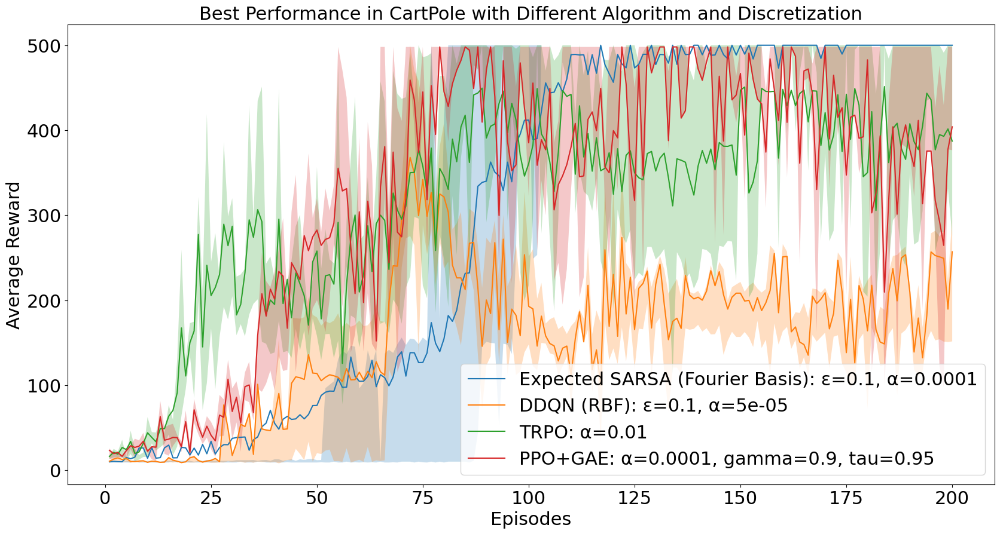

In [303]:
plot_summary_performances_v2(best_summary, title='Best Performance in CartPole with Different Algorithm and Discretization', legend_position='lower right', size=22)

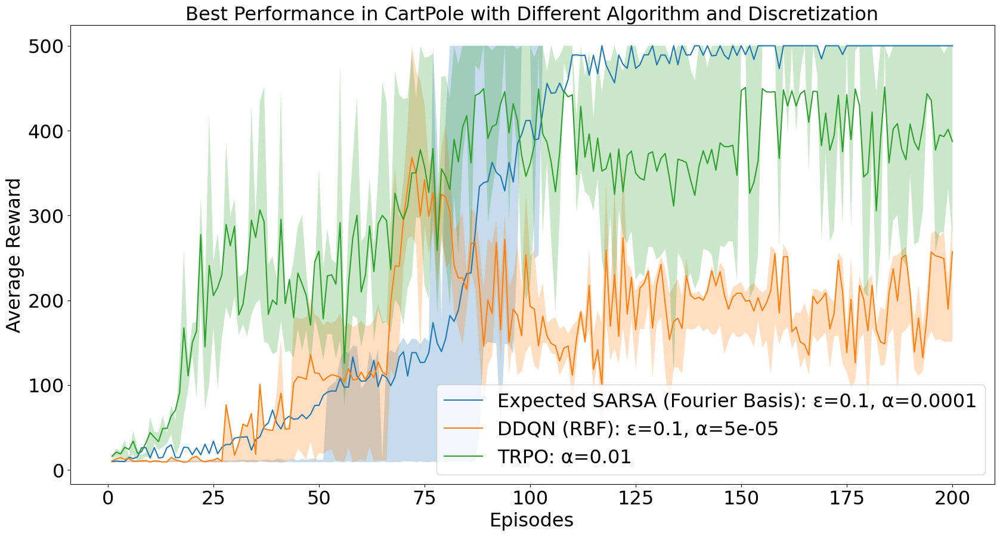

In [217]:
plot_summary_performances_v2(best_summary, title='Best Performance in CartPole with Different Algorithm and Discretization', legend_position='lower right', size=23)

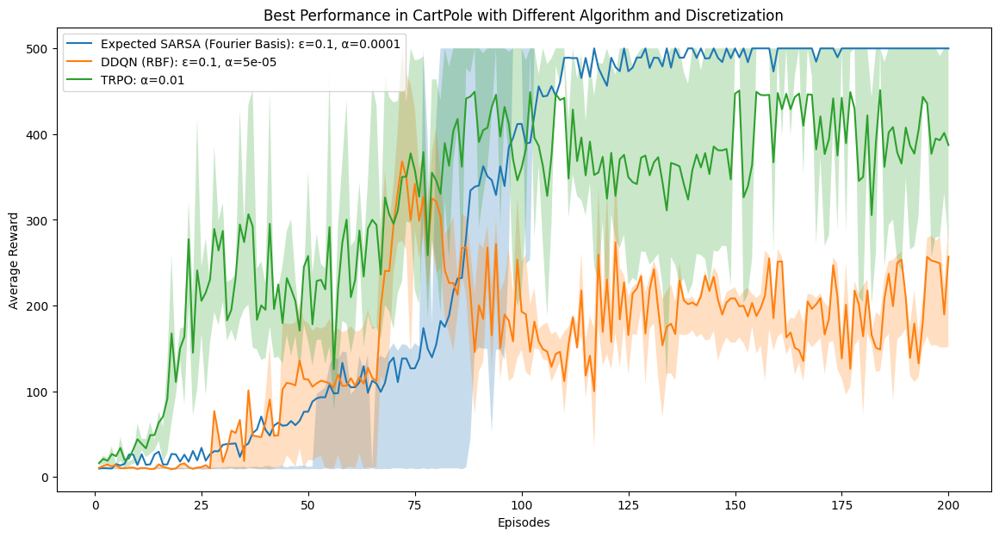

In [102]:
plot_summary_performances(best_summary, title='Best Performance in CartPole with Different Algorithm and Discretization')

In [304]:
cumulative = calculate_overall_metrics(summary)
cumulative

[{'algorithm_name': 'Expected SARSA (RBF)',
  'alpha': 0.2,
  'epsilon': 0.1,
  'cumulative_rewards': 13002.833333333334,
  'overall_average': 65.01416666666667,
  'overall_std_error': 1.5042948126007722},
 {'algorithm_name': 'Expected SARSA (Tile Coding)',
  'alpha': 0.0625,
  'epsilon': 0.001,
  'cumulative_rewards': 14566.4,
  'overall_average': 72.832,
  'overall_std_error': 0.8619518302086259},
 {'algorithm_name': 'Expected SARSA (Fourier Basis)',
  'alpha': 0.0001,
  'epsilon': 0.1,
  'cumulative_rewards': 60272.23333333334,
  'overall_average': 301.3611666666667,
  'overall_std_error': 3.035427236777905},
 {'algorithm_name': 'DDQN (RBF)',
  'alpha': 5e-05,
  'epsilon': 0.1,
  'cumulative_rewards': 31501.25,
  'overall_average': 157.50625,
  'overall_std_error': 4.482172319441977},
 {'algorithm_name': 'DDQN (Tile Coding)',
  'alpha': 0.0001,
  'epsilon': 0.01,
  'cumulative_rewards': 9129.699999999999,
  'overall_average': 45.6485,
  'overall_std_error': 1.6186552980406297},
 {'a

|CartPole|
| Algorithm Name                 | Alpha   | Epsilon | Cumulative Rewards | Overall Average | Overall Std Error |
|--------------------------------|---------|---------|--------------------|-----------------|-------------------|
| Expected SARSA (RBF)           | 0.2     | 0.1     | 13002.83           | 65.01           | 1.50              |
| Expected SARSA (Tile Coding)   | 0.0625  | 0.001   | 14566.4            | 72.83           | 0.86              |
| Expected SARSA (Fourier Basis) | 0.0001  | 0.1     | 60272.23           | 301.36          | 3.04              |
| DDQN (RBF)                     | 0.00005 | 0.1     | 31501.25           | 157.51          | 4.48              |
| DDQN (Tile Coding)             | 0.0001  | 0.01    | 9129.7             | 45.65           | 1.62              |
| DDQN (Fourier Basis)           | 0.0005  | 0.1     | 24356.0            | 121.78          | 6.90              |
| TRPO                           | 0.01    | N/A     | 63322.8            | 316.61          | 4.99              |
| PPO+GAE                        | 0.0001  | N/A     | 64603.8            | 323.02          | 6.61              |


In [83]:
# save Expected SARSA summary
save_rewards_data(summary, "CartPole_Summary_200episodes")

Rewards data saved to CartPole_Summary_200episodes


## MountainCar Expected SARSA

In [218]:
rbf_data = load_rewards_data("Expected_SARSA_RBF/Expected_SARSA_RBF_MountainCar")
tc_data = reverse_keys(load_rewards_data("Expected_SARSA_TC/MC/Results_ES_MC_TC_2.pkl"))
four_data = reverse_keys(load_rewards_data("Expected_SARSA_Fourier/MC/Results_ES_MC_.pkl"))


Rewards data loaded from Expected_SARSA_RBF/Expected_SARSA_RBF_MountainCar
Rewards data loaded from Expected_SARSA_TC/MC/Results_ES_MC_TC_2.pkl
Rewards data loaded from Expected_SARSA_Fourier/MC/Results_ES_MC_.pkl


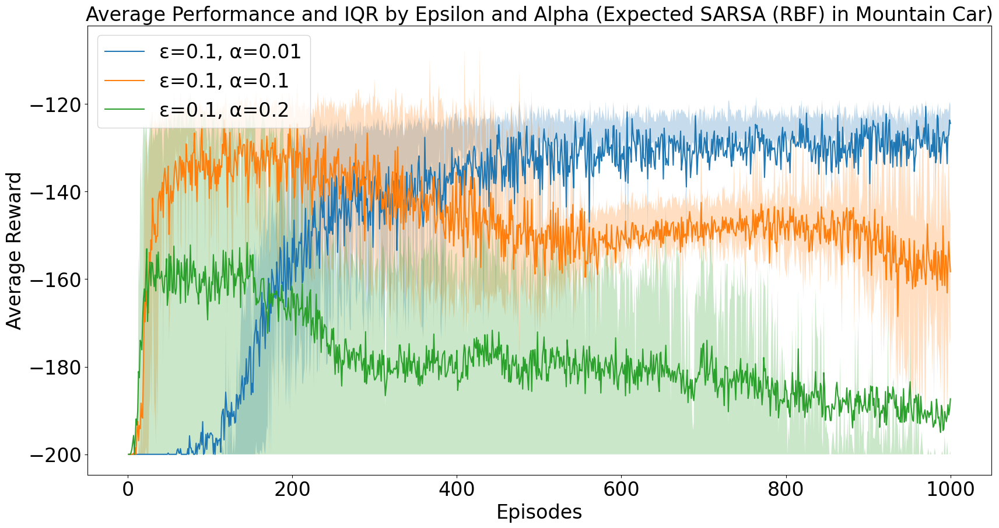

In [219]:
# RBF
plot_rewards_v2(rbf_data, algorithm_name="Expected SARSA", dec="RBF", env="Mountain Car")

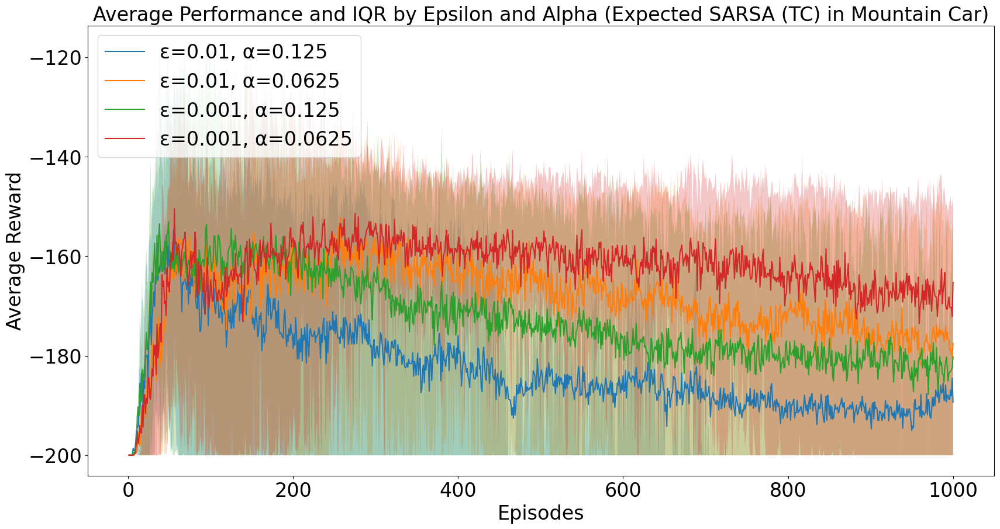

In [220]:
# TC
plot_rewards_v2(tc_data, algorithm_name="Expected SARSA", dec="TC", env="Mountain Car")

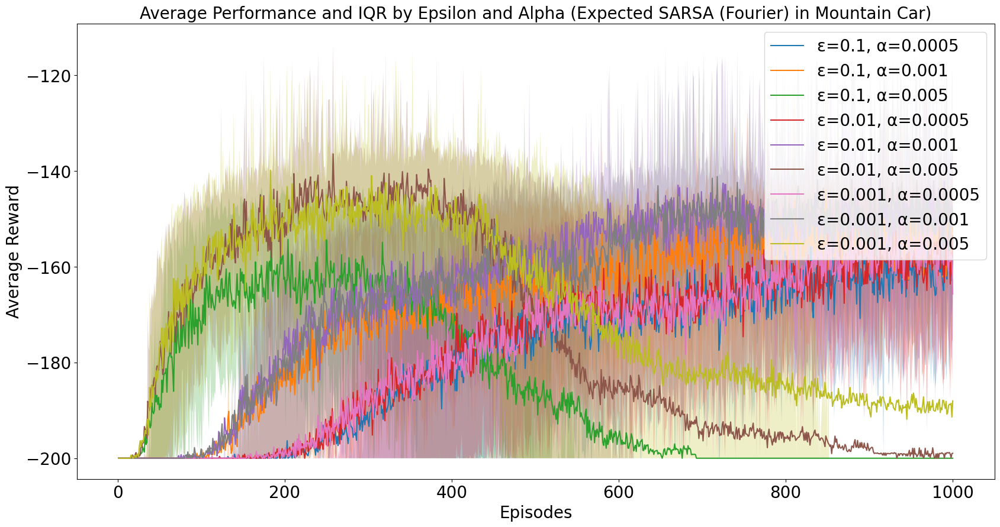

In [225]:
# Fourier
plot_rewards_v2(four_data, algorithm_name="Expected SARSA", dec="Fourier", env="Mountain Car", legend_position='upper right', size=20)

In [226]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.01, epsilon=0.1, algorithm_name="Expected SARSA (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0625, epsilon=0.001, algorithm_name="Expected SARSA (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.001, epsilon=0.001, algorithm_name="Expected SARSA (Fourier Basis)")

summary = [
    best_rbf,
    best_tc,
    best_four
]

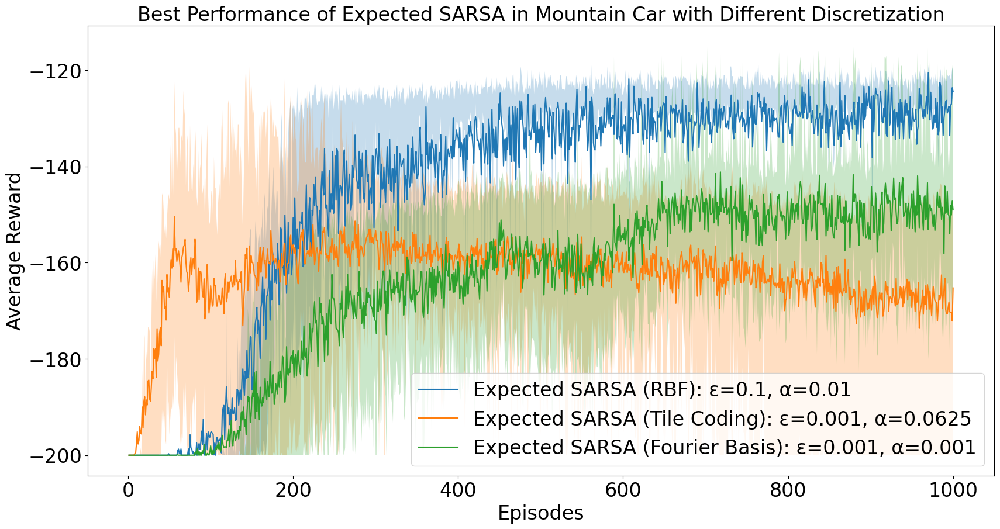

In [227]:
plot_summary_performances_v2(summary, title='Best Performance of Expected SARSA in Mountain Car with Different Discretization', legend_position='lower right')

In [165]:
# save Expected SARSA summary
save_rewards_data(summary, "MountainCar_ES_Summary")

Rewards data saved to MountainCar_ES_Summary


## MountainCar DDQN

In [228]:
rbf_data = load_rewards_data("DDQN_RBF/DDQN_RBF_MC_Combined.pkl")
tc_data = load_rewards_data("DDQN_TC_Cheryl/DDQN_TC_MC.pkl")
four_data = load_rewards_data("DDQN_Fourier/DDQN_Fourier_MC.pkl")

Rewards data loaded from DDQN_RBF/DDQN_RBF_MC_Combined.pkl
Rewards data loaded from DDQN_TC_Cheryl/DDQN_TC_MC.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_MC.pkl


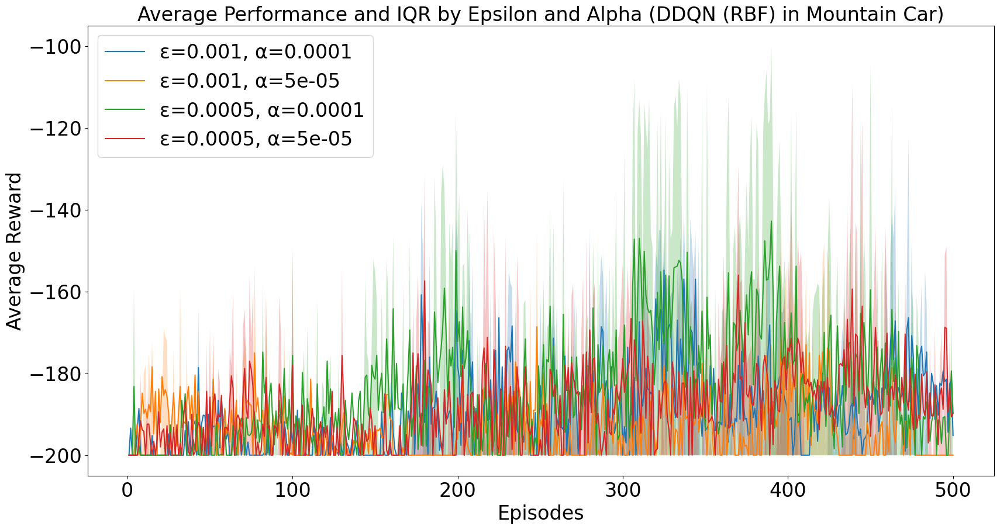

In [229]:
# RBF
plot_rewards_v2(rbf_data, algorithm_name="DDQN", dec="RBF", env="Mountain Car")

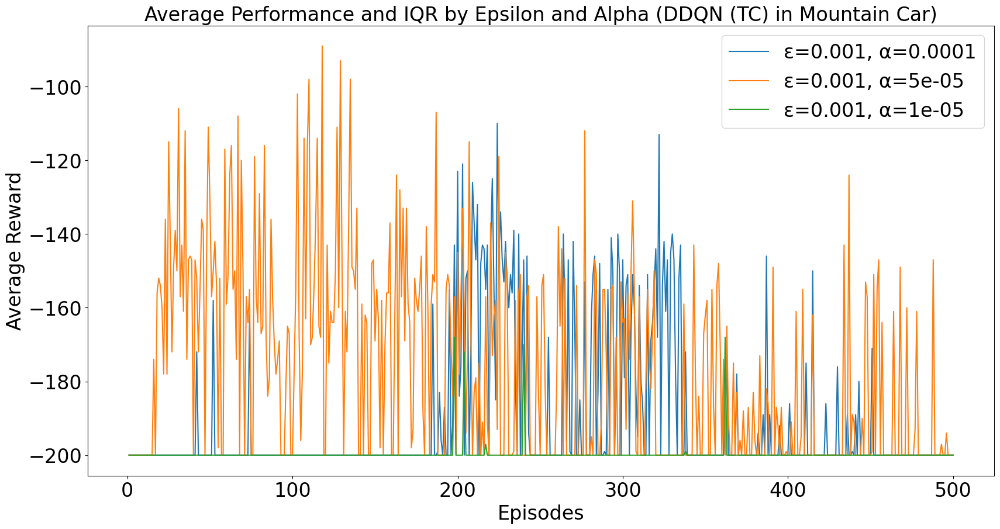

In [230]:
# TC
plot_rewards_v2(tc_data, algorithm_name="DDQN", dec="TC", env="Mountain Car", legend_position='upper right')

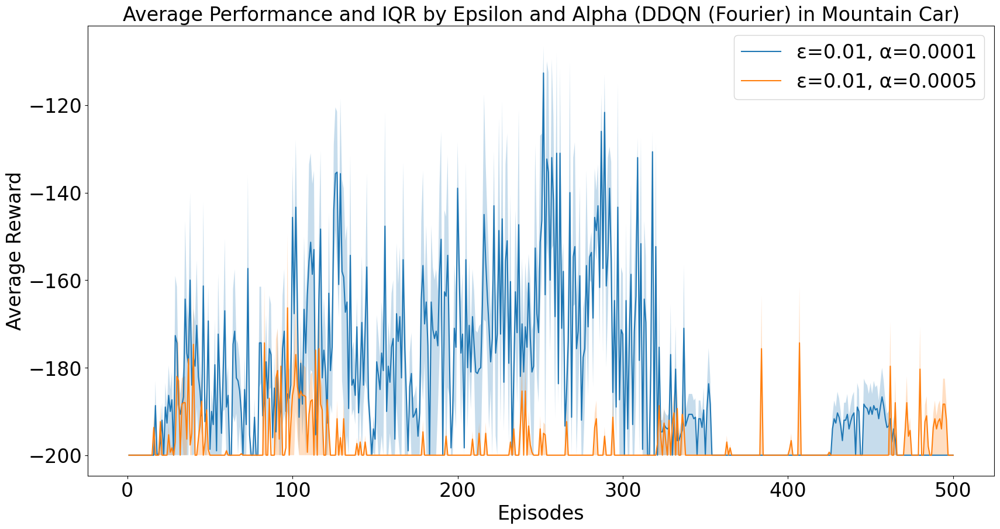

In [231]:
# Fourier
plot_rewards_v2(four_data, algorithm_name="DDQN", dec="Fourier", env="Mountain Car", legend_position='upper right')

In [232]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.0001, epsilon=0.0005, algorithm_name="DDQN (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=1e-4, epsilon=0.001, algorithm_name="DDQN (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.0001, epsilon=0.01, algorithm_name="DDQN (Fourier Basis)")

summary = [
    best_rbf,
    best_tc,
    best_four
]

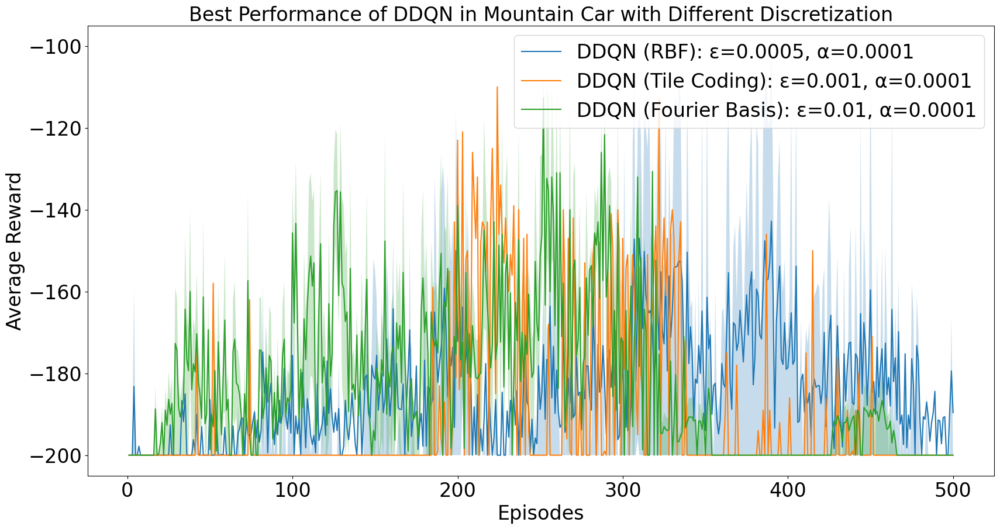

In [234]:
plot_summary_performances_v2(summary, title='Best Performance of DDQN in Mountain Car with Different Discretization', legend_position='upper right')


In [176]:
# save DDQN summary
save_rewards_data(summary, "MountainCar_DDQN_Summary")

Rewards data saved to MountainCar_DDQN_Summary


## MountainCar TRPO

In [235]:
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_MC_200.pkl"), alpha=0.01, epsilon="N/A")

Rewards data loaded from TRPO/Results_TRPO_MC_200.pkl


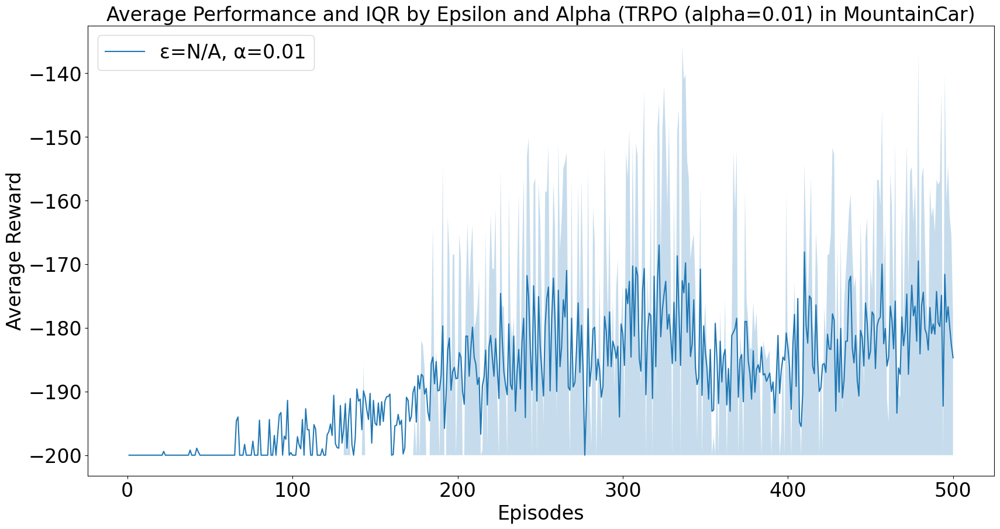

In [236]:
plot_rewards_v2(trpo_data, algorithm_name="TRPO", dec="alpha=0.01", env="MountainCar")

## MountainCar PPO+GAE

In [7]:
configs = [
    {'lr_policy': 1e-3, 'gamma': 0.1, 'gae_lambda': 0.1, 'file': 'PPOGAE/MC results/mean_rewards_0.001_0.1_0.1.pkl'},
    {'lr_policy': 1e-3, 'gamma': 0.1, 'gae_lambda': 0.9, 'file': 'PPOGAE/MC results/mean_rewards_0.001_0.1_0.9.pkl'},
    {'lr_policy': 1e-3, 'gamma': 0.9, 'gae_lambda': 0.1, 'file': 'PPOGAE/MC results/mean_rewards_0.001_0.9_0.1.pkl'},
    {'lr_policy': 1e-3, 'gamma': 0.9, 'gae_lambda': 0.9, 'file': 'PPOGAE/MC results/mean_rewards_0.001_0.9_0.9.pkl'},
    {'lr_policy': 1e-4, 'gamma': 0.1, 'gae_lambda': 0.1, 'file': 'PPOGAE/MC results/mean_rewards_0.0001_0.1_0.1.pkl'},
    {'lr_policy': 1e-4, 'gamma': 0.1, 'gae_lambda': 0.9, 'file': 'PPOGAE/MC results/mean_rewards_0.0001_0.1_0.9.pkl'},
    {'lr_policy': 1e-4, 'gamma': 0.9, 'gae_lambda': 0.1, 'file': 'PPOGAE/MC results/mean_rewards_0.0001_0.9_0.1.pkl'},
    {'lr_policy': 1e-4, 'gamma': 0.9, 'gae_lambda': 0.9, 'file': 'PPOGAE/MC results/mean_rewards_0.0001_0.9_0.9.pkl'},
    # add more configurations if needed
]

Rewards data loaded from PPOGAE/MC results/mean_rewards_0.001_0.1_0.1.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.001_0.1_0.9.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.001_0.9_0.1.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.001_0.9_0.9.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.0001_0.1_0.1.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.0001_0.1_0.9.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.0001_0.9_0.1.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.0001_0.9_0.9.pkl


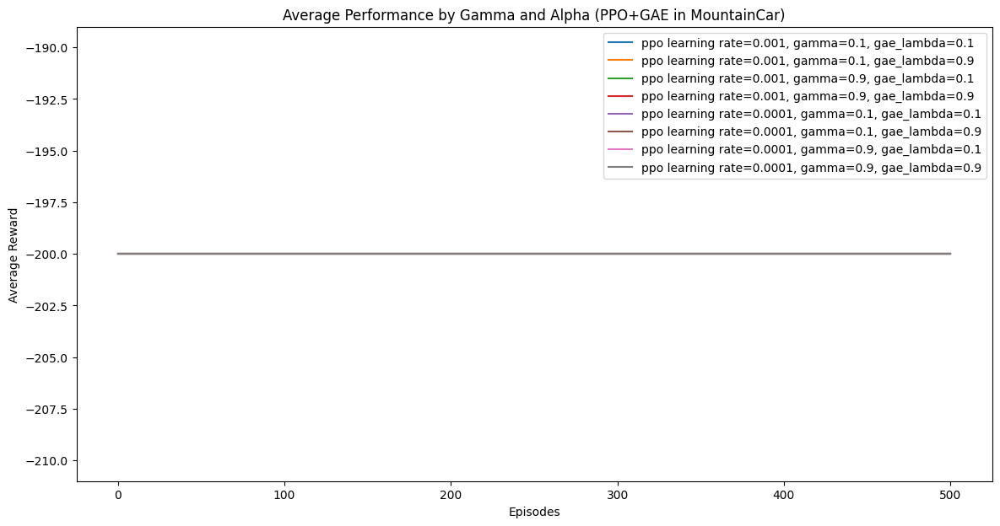

In [85]:
plot_gae_plot(configs=configs, title="Average Performance by Gamma and Alpha (PPO+GAE in MountainCar)")

## MountainCar Combined

In [15]:
rbf_data = trim_rewards(load_rewards_data("Expected_SARSA_RBF/Expected_SARSA_RBF_MountainCar"), episodes=500)
tc_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_TC/MC/Results_ES_MC_TC_2.pkl")), episodes=500)
four_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_Fourier/MC/Results_ES_MC_.pkl")), episodes=500)
rbf_data_d = load_rewards_data("DDQN_RBF/DDQN_RBF_MC_Combined.pkl")
tc_data_d = load_rewards_data("DDQN_TC_Cheryl/DDQN_TC_MC.pkl")
four_data_d = load_rewards_data("DDQN_Fourier/DDQN_Fourier_MC.pkl")
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_MC_200.pkl"), alpha=0.01, epsilon="N/A")
ppo_data = load_rewards_data('PPOGAE/MC results/mean_rewards_0.0001_0.9_0.9.pkl')

best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.01, epsilon=0.1, algorithm_name="Expected SARSA (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0625, epsilon=0.001, algorithm_name="Expected SARSA (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.001, epsilon=0.001, algorithm_name="Expected SARSA (Fourier Basis)")
best_rbf_d = get_data_with_metadata(original_data=rbf_data_d, alpha=0.0001, epsilon=0.0005, algorithm_name="DDQN (RBF)")
best_tc_d = get_data_with_metadata(original_data=tc_data_d, alpha=1e-4, epsilon=0.001, algorithm_name="DDQN (Tile Coding)")
best_four_d = get_data_with_metadata(original_data=four_data_d, alpha=0.0001, epsilon=0.01, algorithm_name="DDQN (Fourier Basis)")
best_trpo = get_data_with_metadata(original_data=trpo_data, alpha=0.01, epsilon='N/A', algorithm_name="TRPO")
best_ppo = get_data_with_metadata_ppogae(original_data=ppo_data, alpha=0.0001, gamma=0.9, tau=0.9, algorithm_name="PPO+GAE")

best_summary = [
    best_rbf,
    best_four_d,
    best_trpo,
    best_ppo
]

summary = [
    best_rbf,
    best_tc,
    best_four,
    best_rbf_d,
    best_tc_d,
    best_four_d,
    best_trpo,
    best_ppo
]

Rewards data loaded from Expected_SARSA_RBF/Expected_SARSA_RBF_MountainCar
Rewards data loaded from Expected_SARSA_TC/MC/Results_ES_MC_TC_2.pkl
Rewards data loaded from Expected_SARSA_Fourier/MC/Results_ES_MC_.pkl
Rewards data loaded from DDQN_RBF/DDQN_RBF_MC_Combined.pkl
Rewards data loaded from DDQN_TC_Cheryl/DDQN_TC_MC.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_MC.pkl
Rewards data loaded from TRPO/Results_TRPO_MC_200.pkl
Rewards data loaded from PPOGAE/MC results/mean_rewards_0.0001_0.9_0.9.pkl


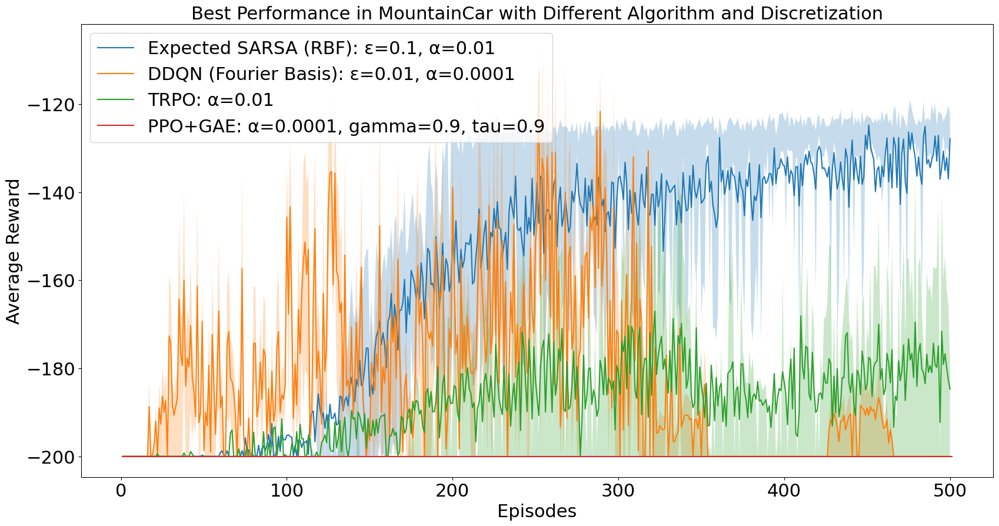

In [18]:
plot_summary_performances_v2(best_summary, title='Best Performance in MountainCar with Different Algorithm and Discretization', size=22)

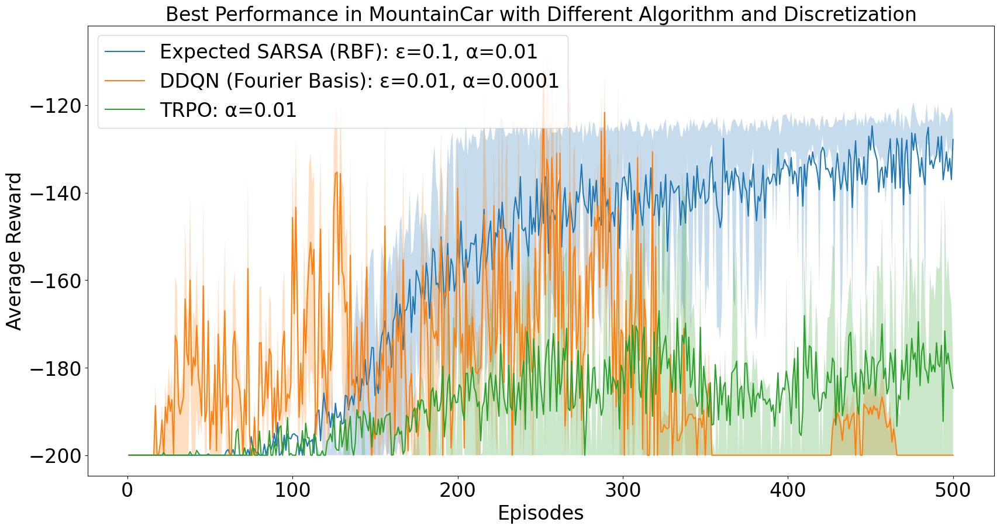

In [238]:
plot_summary_performances_v2(best_summary, title='Best Performance in MountainCar with Different Algorithm and Discretization')

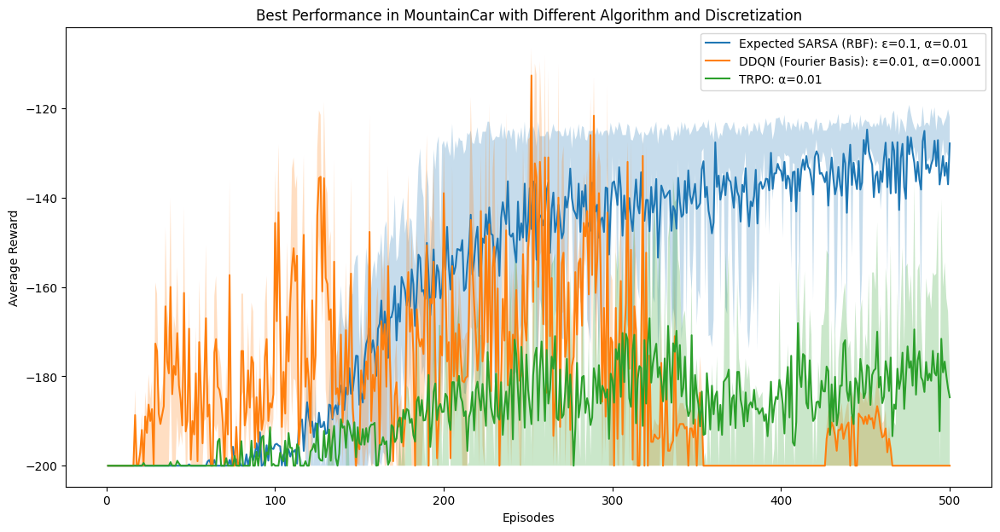

In [46]:
plot_summary_performances(best_summary, title='Best Performance in MountainCar with Different Algorithm and Discretization')

In [19]:
cumulative = calculate_overall_metrics(summary)
cumulative

[{'algorithm_name': 'Expected SARSA (RBF)',
  'alpha': 0.01,
  'epsilon': 0.1,
  'cumulative_rewards': -79667.83333333334,
  'overall_average': -159.33566666666667,
  'overall_std_error': 0.2745401724770051},
 {'algorithm_name': 'Expected SARSA (Tile Coding)',
  'alpha': 0.0625,
  'epsilon': 0.001,
  'cumulative_rewards': -80910.70000000001,
  'overall_average': -161.8214,
  'overall_std_error': 0.18891016087442197},
 {'algorithm_name': 'Expected SARSA (Fourier Basis)',
  'alpha': 0.001,
  'epsilon': 0.001,
  'cumulative_rewards': -88779.36000000002,
  'overall_average': -177.55872,
  'overall_std_error': 0.15699985120522883},
 {'algorithm_name': 'DDQN (RBF)',
  'alpha': 0.0001,
  'epsilon': 0.0005,
  'cumulative_rewards': -92147.2,
  'overall_average': -184.2944,
  'overall_std_error': 0.5558384400668956},
 {'algorithm_name': 'DDQN (Tile Coding)',
  'alpha': 0.0001,
  'epsilon': 0.001,
  'cumulative_rewards': -95387.0,
  'overall_average': -190.774,
  'overall_std_error': 0.8648594382

| Mountain Car|
| Algorithm Name                 | Alpha  | Epsilon | Cumulative Rewards   | Overall Average | Overall Std Error |
|--------------------------------|--------|---------|----------------------|-----------------|-------------------|
| Expected SARSA (RBF)           | 0.01   | 0.1     | -79667.83            | -159.34         | 0.27              |
| Expected SARSA (Tile Coding)   | 0.0625 | 0.001   | -80910.70            | -161.82         | 0.19              |
| Expected SARSA (Fourier Basis) | 0.001  | 0.001   | -88779.36            | -177.56         | 0.16              |
| DDQN (RBF)                     | 0.0001 | 0.0005  | -92147.2             | -184.29         | 0.56              |
| DDQN (Tile Coding)             | 0.0001 | 0.001   | -95387.0             | -190.77         | 0.86              |
| DDQN (Fourier Basis)           | 0.0001 | 0.01    | -91428.0             | -182.86         | 0.71              |
| TRPO                           | 0.01   | N/A     | -94144.4            | -188.29         | 0.33              |


In [42]:
# save Expected SARSA summary
save_rewards_data(summary, "MountainCar_Summary_500episodes")

Rewards data saved to MountainCar_Summary_500episodes


## MCC Expected SARSA

In [239]:
rbf_data = reverse_keys(load_rewards_data("Expected_SARSA_RBF/ExpectedSARSA_RBF_MCC.pkl"))
tc_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_TC/MCC/Results_ES_TC_MCC_.pkl")), episodes=1000)
four_data = reverse_keys(load_rewards_data("Expected_SARSA_Fourier/MC/Results_ES_MCC_.pkl"))


Rewards data loaded from Expected_SARSA_RBF/ExpectedSARSA_RBF_MCC.pkl
Rewards data loaded from Expected_SARSA_TC/MCC/Results_ES_TC_MCC_.pkl
Rewards data loaded from Expected_SARSA_Fourier/MC/Results_ES_MCC_.pkl


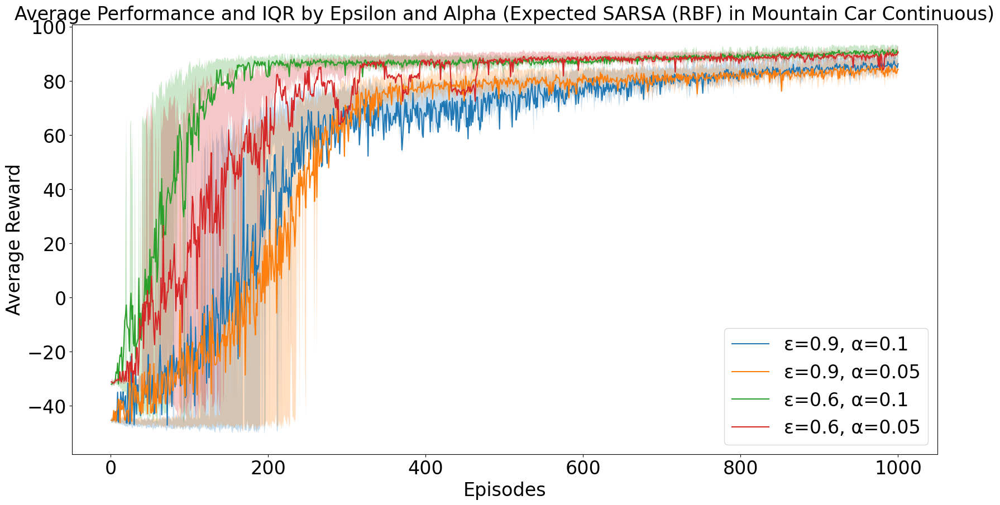

In [240]:
# RBF
plot_rewards_v2(rbf_data, algorithm_name="Expected SARSA", dec="RBF", env="Mountain Car Continuous", legend_position='lower right')

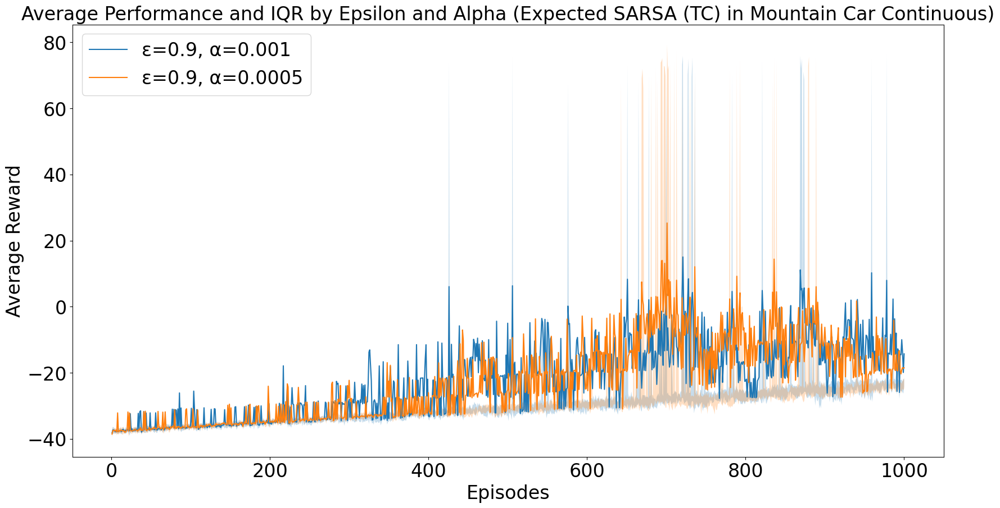

In [241]:
# TC
plot_rewards_v2(tc_data, algorithm_name="Expected SARSA", dec="TC", env="Mountain Car Continuous")

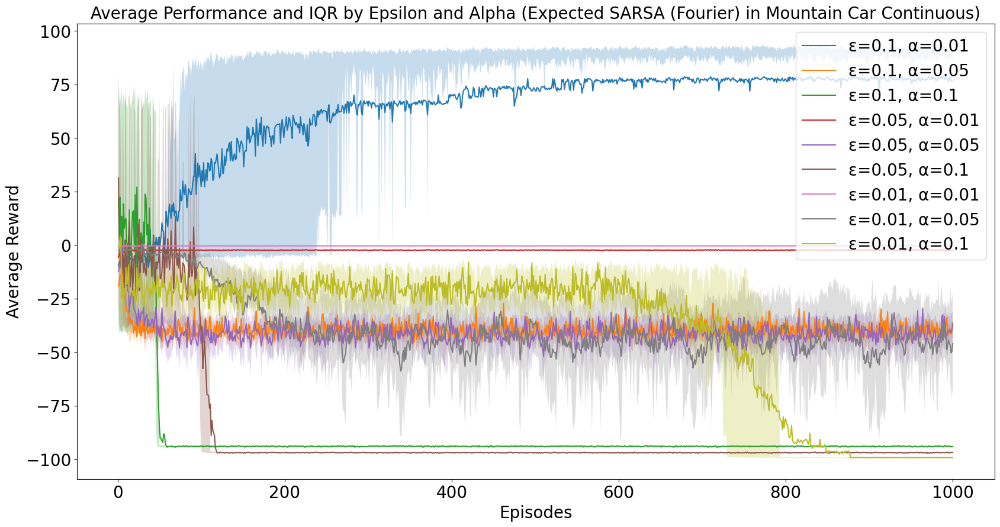

In [243]:
# Fourier
plot_rewards_v2(four_data, algorithm_name="Expected SARSA", dec="Fourier", env="Mountain Car Continuous", legend_position='upper right', size=20)

In [244]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.1, epsilon=0.6, algorithm_name="Expected SARSA (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0005, epsilon=0.9, algorithm_name="Expected SARSA (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.01, epsilon=0.1, algorithm_name="Expected SARSA (Fourier Basis)")

summary = [
    best_rbf,
    best_tc,
    best_four
]

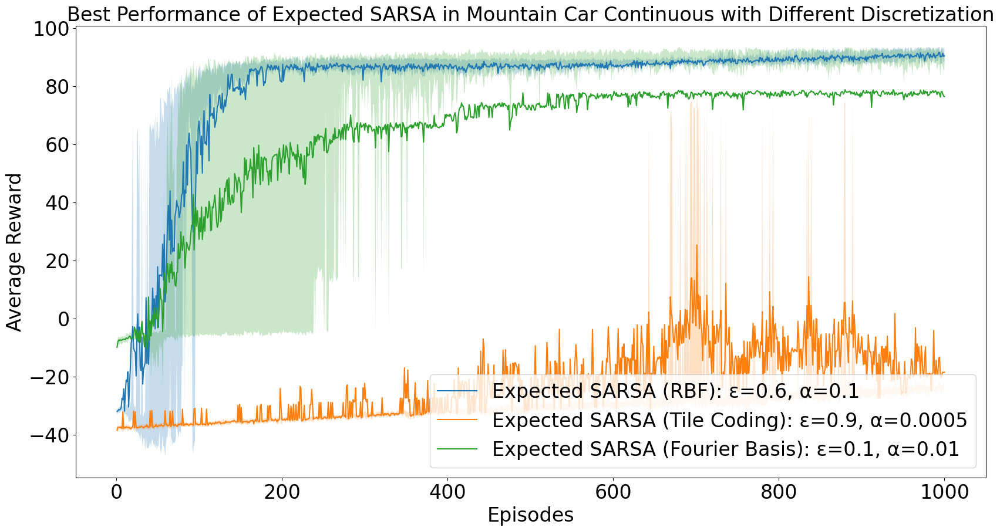

In [246]:
plot_summary_performances_v2(summary, title='Best Performance of Expected SARSA in Mountain Car Continuous with Different Discretization', legend_position='lower right')


In [220]:
# save DDQN summary
save_rewards_data(summary, "MCC_ES_Summary")

Rewards data saved to MCC_ES_Summary


## MCC DDQN

In [247]:
rbf_data = load_rewards_data("DDQN_RBF/MCC_DDQN_RBF_1run.pkl")
tc_data = load_rewards_data("DDQN_TC_Cheryl/DDQN_TC_MCC.pkl")
four_data = load_rewards_data("DDQN_Fourier/DDQN_Fourier_MCC_new.pkl")


Rewards data loaded from DDQN_RBF/MCC_DDQN_RBF_1run.pkl
Rewards data loaded from DDQN_TC_Cheryl/DDQN_TC_MCC.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_MCC_new.pkl


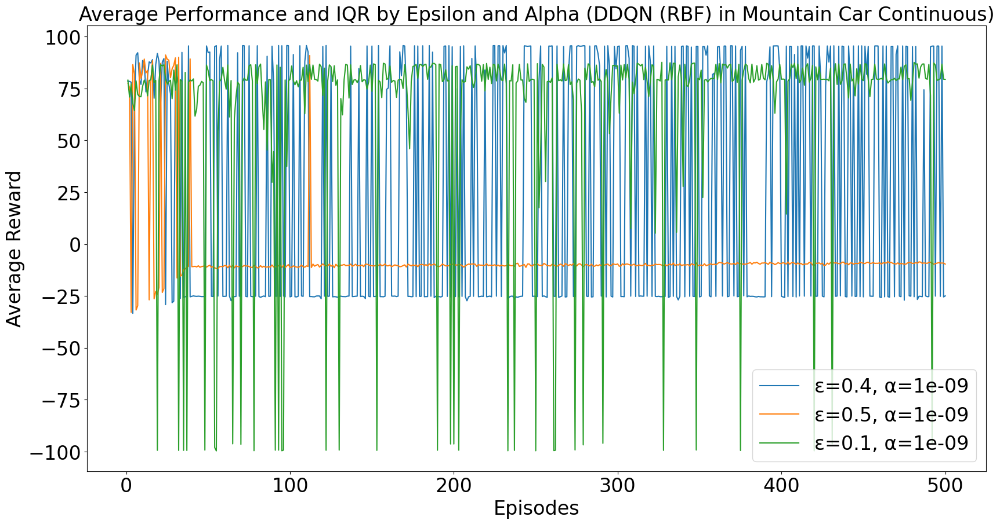

In [249]:
# RBF
plot_rewards_v2(rbf_data, algorithm_name="DDQN", dec="RBF", env="Mountain Car Continuous", legend_position='lower right')

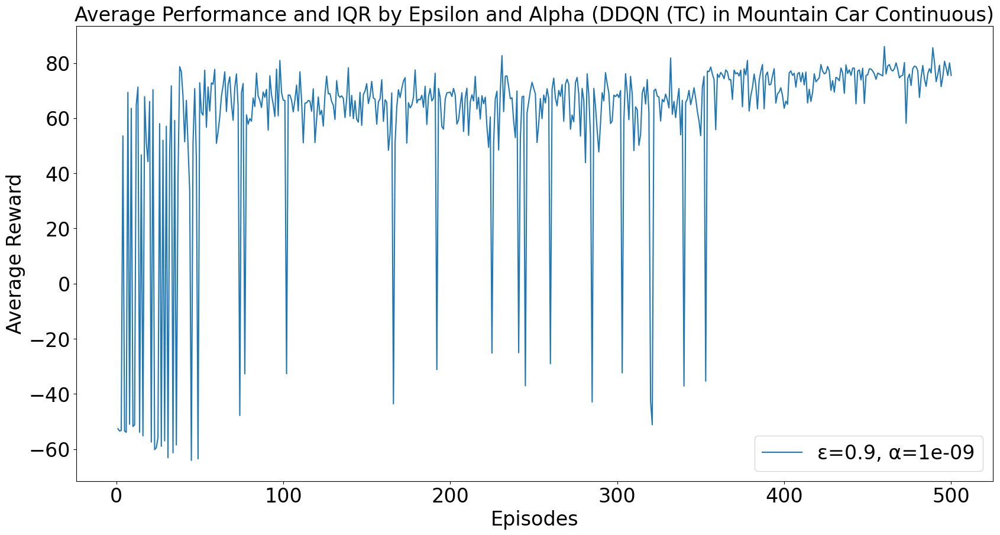

In [250]:
# TC
plot_rewards_v2(tc_data, algorithm_name="DDQN", dec="TC", env="Mountain Car Continuous", legend_position='lower right')

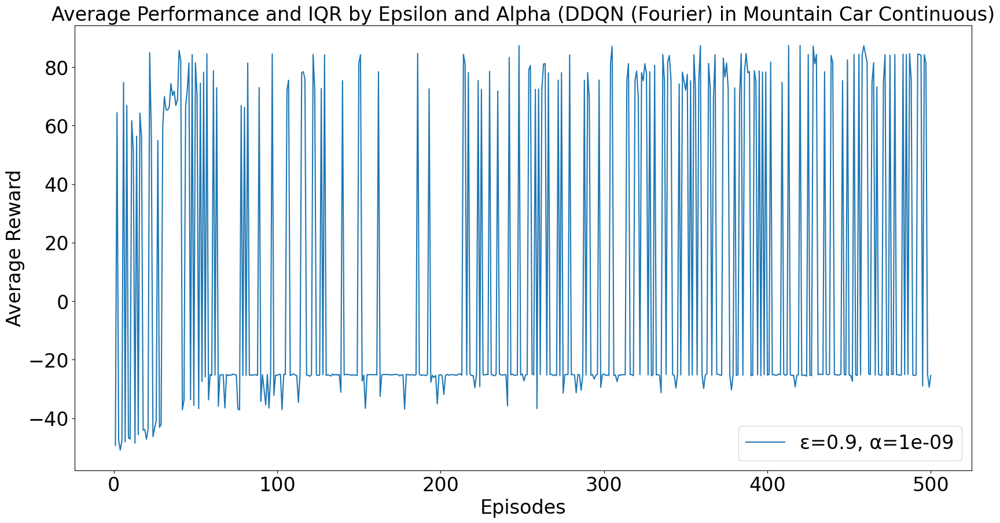

In [253]:
# Fourier
plot_rewards_v2(four_data, algorithm_name="DDQN", dec="Fourier", env="Mountain Car Continuous", legend_position='lower right')

In [254]:
best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=1e-9, epsilon=0.1, algorithm_name="DDQN (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=1e-9, epsilon=0.9, algorithm_name="DDQN (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=1e-9, epsilon=0.9, algorithm_name="DDQN (Fourier Basis)")

summary = [
    best_rbf,
    best_tc,
    best_four
]

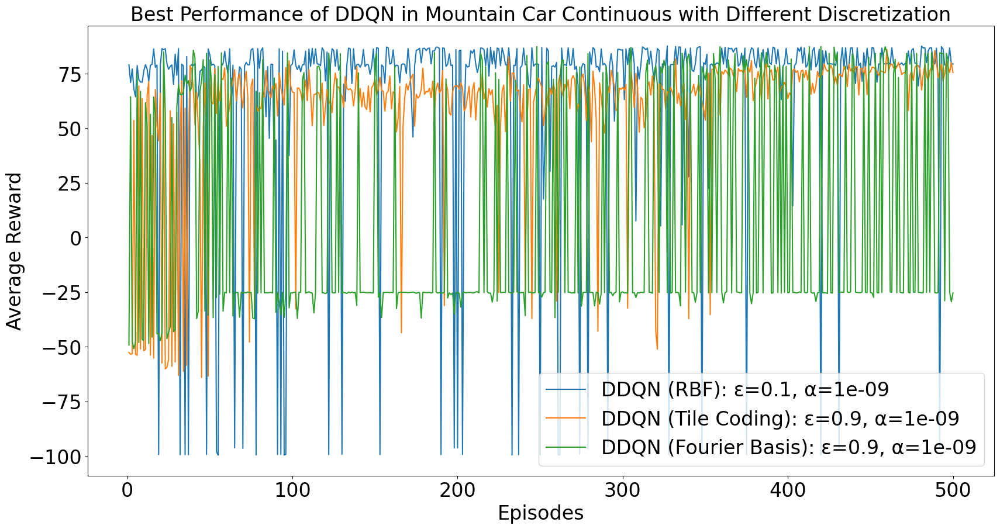

In [255]:
plot_summary_performances_v2(summary, title='Best Performance of DDQN in Mountain Car Continuous with Different Discretization', legend_position='lower right')

In [248]:
# save DDQN summary
save_rewards_data(summary, "MCC_DDQN_Summary")

Rewards data saved to MCC_DDQN_Summary


## MCC TRPO

In [256]:
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_MCC.pkl"), alpha=0.01, epsilon="N/A")

Rewards data loaded from TRPO/Results_TRPO_MCC.pkl


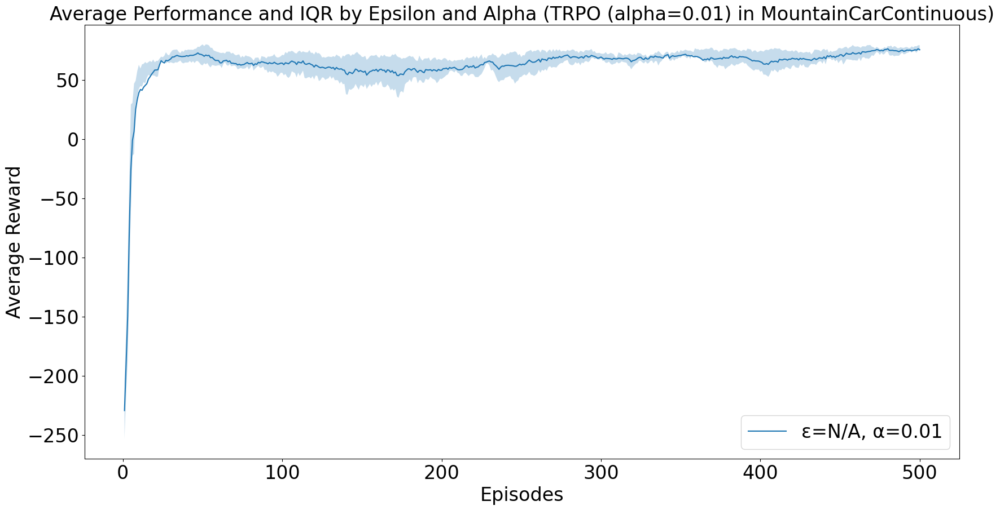

In [257]:
plot_rewards_v2(trpo_data, algorithm_name="TRPO", dec="alpha=0.01", env="MountainCarContinuous", legend_position='lower right')

## MCC PPO+GAE

In [305]:
ppo_data = load_rewards_data("PPOGAE/Results_PPO+GAE_MCC.pkl")

Rewards data loaded from PPOGAE/Results_PPO+GAE_MCC.pkl


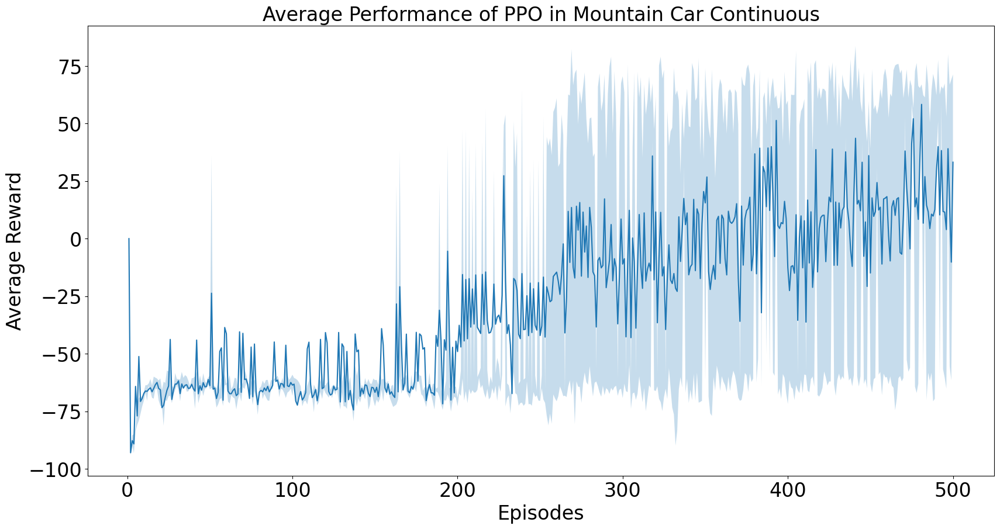

In [307]:
plot_ppo_plot_v2(configs=ppo_data, title="Average Performance of PPO in Mountain Car Continuous", tau=0.1, gamma=0.9)


## MCC Combined

In [310]:
rbf_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_RBF/ExpectedSARSA_RBF_MCC.pkl")), episodes=500)
tc_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_TC/MCC/Results_ES_TC_MCC_.pkl")), episodes=500)
four_data = trim_rewards(reverse_keys(load_rewards_data("Expected_SARSA_Fourier/MC/Results_ES_MCC_.pkl")), episodes=500)
rbf_data_d = load_rewards_data("DDQN_RBF/MCC_DDQN_RBF_1run.pkl")
tc_data_d = load_rewards_data("DDQN_TC_Cheryl/DDQN_TC_MCC.pkl")
four_data_d = load_rewards_data("DDQN_Fourier/DDQN_Fourier_MCC_new.pkl")
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_MCC.pkl"), alpha=0.01, epsilon="N/A")
ppo_data = load_rewards_data("PPOGAE/Results_PPO+GAE_MCC.pkl")

best_rbf = get_data_with_metadata(original_data=rbf_data, alpha=0.1, epsilon=0.6, algorithm_name="Expected SARSA (RBF)")
best_tc = get_data_with_metadata(original_data=tc_data, alpha=0.0005, epsilon=0.9, algorithm_name="Expected SARSA (Tile Coding)")
best_four = get_data_with_metadata(original_data=four_data, alpha=0.01, epsilon=0.1, algorithm_name="Expected SARSA (Fourier Basis)")
best_rbf_d = get_data_with_metadata(original_data=rbf_data_d, alpha=1e-9, epsilon=0.1, algorithm_name="DDQN (RBF)")
best_tc_d = get_data_with_metadata(original_data=tc_data_d, alpha=1e-9, epsilon=0.9, algorithm_name="DDQN (Tile Coding)")
best_four_d = get_data_with_metadata(original_data=four_data_d, alpha=1e-9, epsilon=0.9, algorithm_name="DDQN (Fourier Basis)")
best_trpo = get_data_with_metadata(original_data=trpo_data, alpha=0.01, epsilon='N/A', algorithm_name="TRPO")
best_ppo = get_data_with_metadata_gae(original_data=ppo_data, alpha=0.001, gamma=0.9, tau=0.1, algorithm_name="PPO+GAE")

best_summary = [
    best_rbf,
    best_tc_d,
    best_trpo,
    best_ppo
]

summary = [
    best_rbf,
    best_tc,
    best_four,
    best_rbf_d,
    best_tc_d,
    best_four_d,
    best_trpo,
    best_ppo
]

Rewards data loaded from Expected_SARSA_RBF/ExpectedSARSA_RBF_MCC.pkl
Rewards data loaded from Expected_SARSA_TC/MCC/Results_ES_TC_MCC_.pkl
Rewards data loaded from Expected_SARSA_Fourier/MC/Results_ES_MCC_.pkl
Rewards data loaded from DDQN_RBF/MCC_DDQN_RBF_1run.pkl
Rewards data loaded from DDQN_TC_Cheryl/DDQN_TC_MCC.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_MCC_new.pkl
Rewards data loaded from TRPO/Results_TRPO_MCC.pkl
Rewards data loaded from PPOGAE/Results_PPO+GAE_MCC.pkl


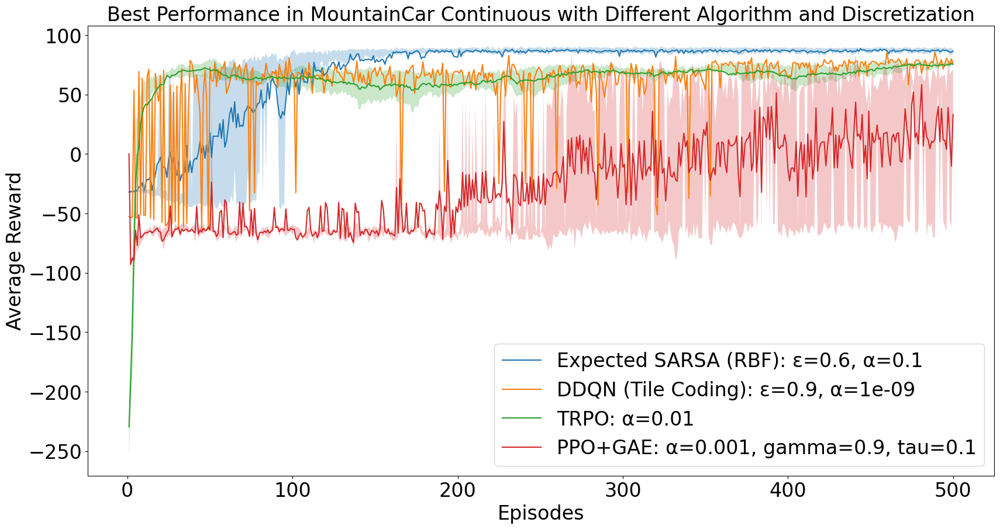

In [311]:
# With best_four_d
plot_summary_performances_v2(best_summary, title='Best Performance in MountainCar Continuous with Different Algorithm and Discretization', legend_position='lower right')

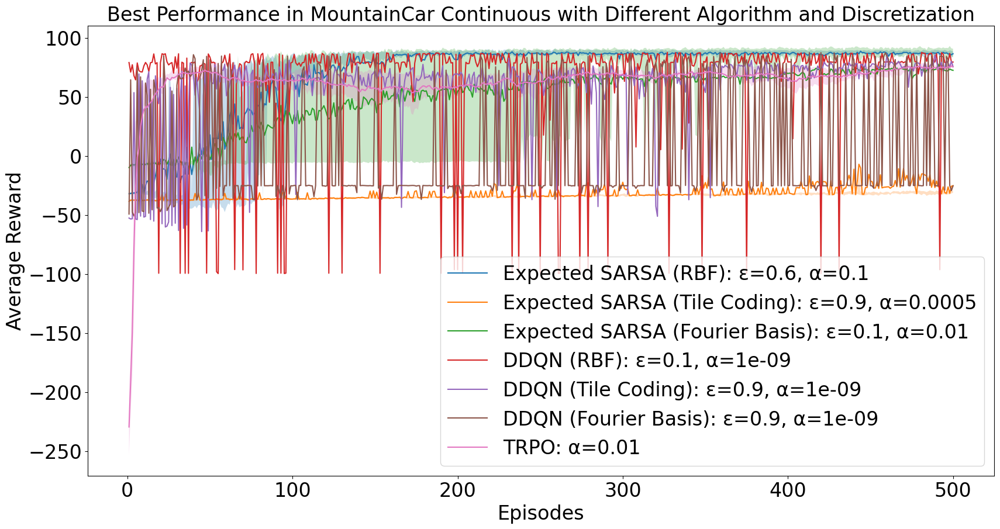

In [260]:
# Without best_four_d
plot_summary_performances_v2(summary, title='Best Performance in MountainCar Continuous with Different Algorithm and Discretization', legend_position='lower right')

In [312]:
cumulative = calculate_overall_metrics(summary)
cumulative

[{'algorithm_name': 'Expected SARSA (RBF)',
  'alpha': 0.1,
  'epsilon': 0.6,
  'cumulative_rewards': 34943.23416666667,
  'overall_average': 69.88646833333334,
  'overall_std_error': 0.3353502957127066},
 {'algorithm_name': 'Expected SARSA (Tile Coding)',
  'alpha': 0.0005,
  'epsilon': 0.9,
  'cumulative_rewards': -15879.272500000025,
  'overall_average': -31.758545000000048,
  'overall_std_error': 0.16841870890966212},
 {'algorithm_name': 'Expected SARSA (Fourier Basis)',
  'alpha': 0.01,
  'epsilon': 0.1,
  'cumulative_rewards': 25120.526666666672,
  'overall_average': 50.24105333333333,
  'overall_std_error': 0.38635452984964225},
 {'algorithm_name': 'DDQN (RBF)',
  'alpha': 1e-09,
  'epsilon': 0.1,
  'cumulative_rewards': 33188.52500000004,
  'overall_average': 66.37705000000008,
  'overall_std_error': 2.0804801739249865},
 {'algorithm_name': 'DDQN (Tile Coding)',
  'alpha': 1e-09,
  'epsilon': 0.9,
  'cumulative_rewards': 29888.899999999976,
  'overall_average': 59.7777999999999

| Continuous Mountain Car|
| Algorithm Name                 | Alpha    | Epsilon | Cumulative Rewards | Overall Average | Overall Std Error |
|--------------------------------|----------|---------|--------------------|-----------------|------------------|
| Expected SARSA (RBF)           | 0.1      | 0.6     | 34943.23           | 69.89           | 0.34             |
| Expected SARSA (Tile Coding)   | 0.0005   | 0.9     | -15879.27          | -31.76          | 0.17             |
| Expected SARSA (Fourier Basis) | 0.01     | 0.1     | 25120.53           | 50.24           | 0.39             |
| DDQN (RBF)                     | 1.00E-09 | 0.1     | 33188.53           | 66.38           | 2.08             |
| DDQN (Tile Coding)             | 1.00E-09 | 0.9     | 29888.90           | 59.78           | 1.40             |
| DDQN (Fourier Basis)           | 1.00E-09 | 0.9     | 3181.15            | 6.36            | 2.20             |
| TRPO                           | 0.01     | N/A     | 31498.8            | 62.99           | 0.43             |
| PPO+GAE                        | 0.001    | N/A     | -13309.56          | -26.62          | 1.20             |


In [40]:
# save DDQN summary
save_rewards_data(summary, "MCC_Summary")

Rewards data saved to MCC_Summary


## Swimmer Expected SARSA


In [261]:
expected_data_v1 = reverse_keys(load_rewards_data("Expected_SARSA_Fourier/Swimmer/Results_ES_SM_.pkl"))
expected_data_v2 = reverse_keys(load_rewards_data("Expected_SARSA_Fourier/Swimmer/Results_ES_SM_2.pkl"))

Rewards data loaded from Expected_SARSA_Fourier/Swimmer/Results_ES_SM_.pkl
Rewards data loaded from Expected_SARSA_Fourier/Swimmer/Results_ES_SM_2.pkl


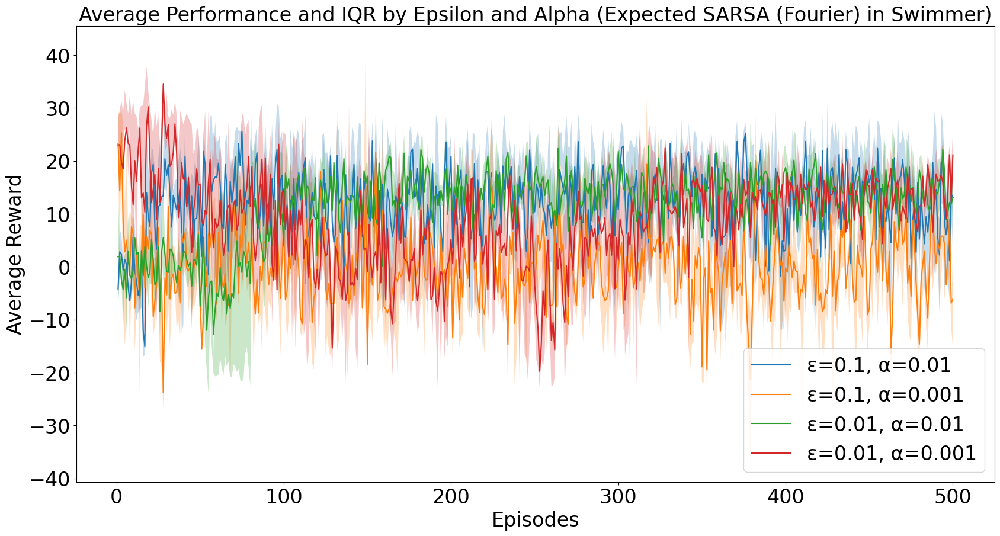

In [263]:
# Version 1
plot_rewards_v2(expected_data_v1, algorithm_name="Expected SARSA", dec="Fourier", env="Swimmer", legend_position='lower right')

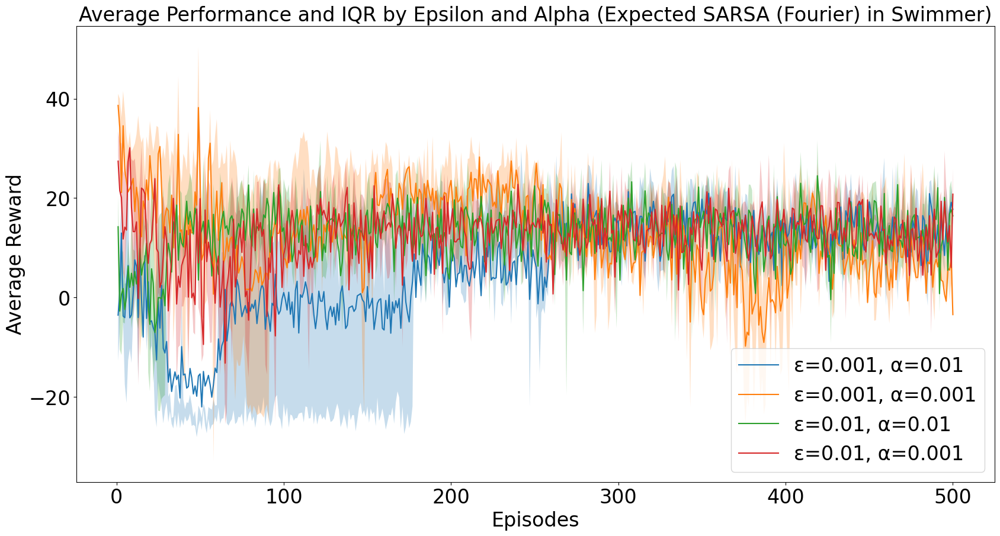

In [264]:
# Version 2
plot_rewards_v2(expected_data_v2, algorithm_name="Expected SARSA", dec="Fourier", env="Swimmer", legend_position='lower right')

## Swimmer DDQN

In [330]:
data = load_rewards_data("DDQN_Fourier/DDQN_Fourier_SM.pkl")

Rewards data loaded from DDQN_Fourier/DDQN_Fourier_SM.pkl


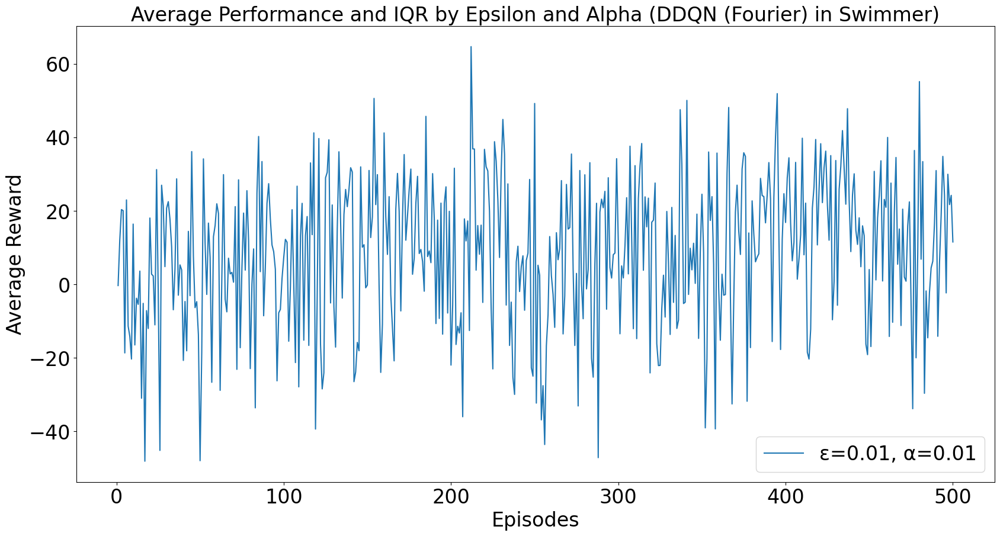

In [323]:
plot_rewards_v2(data, algorithm_name="DDQN", dec="Fourier", env="Swimmer", legend_position='lower right')

## Swimmer TRPO

In [265]:
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_SM.pkl"), alpha=0.01, epsilon="N/A")

Rewards data loaded from TRPO/Results_TRPO_SM.pkl


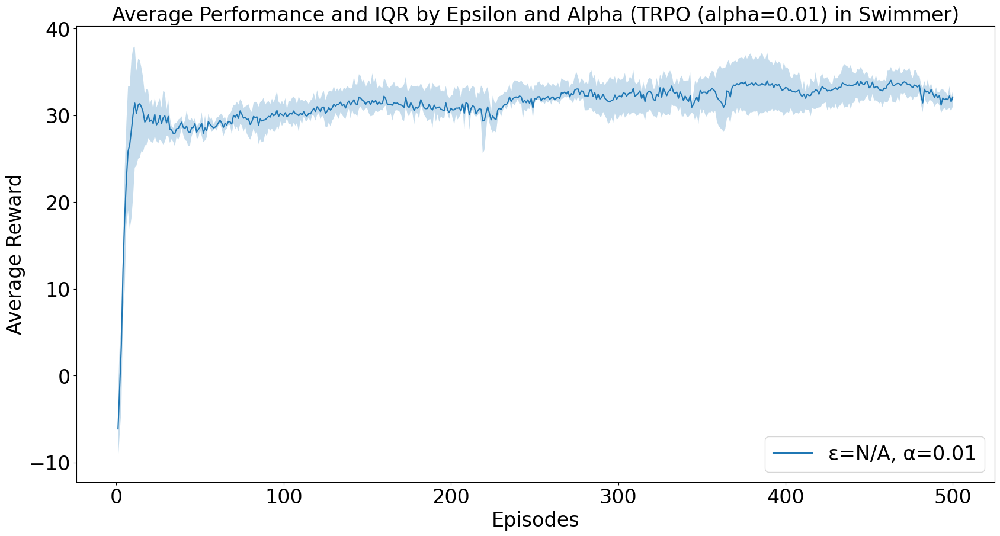

In [266]:
plot_rewards_v2(trpo_data, algorithm_name="TRPO", dec="alpha=0.01", env="Swimmer", legend_position='lower right')

## Swimmer PPO+GAE

In [320]:
ppo_data = rename_key(load_rewards_data("PPOGAE/Results_PPO_SM.pkl"), old_key='TRPO', new_key='PPO_GAE')

Rewards data loaded from PPOGAE/Results_PPO_SM.pkl


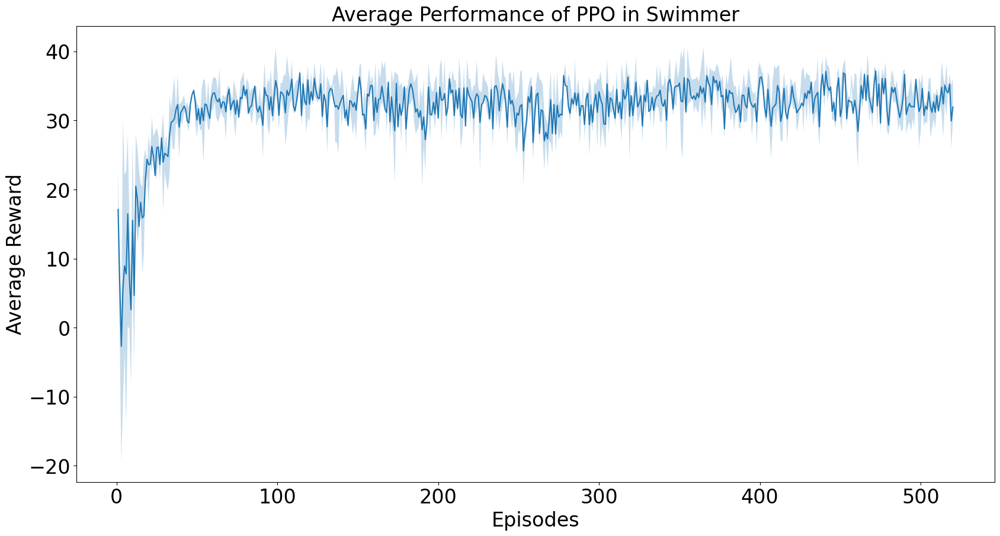

In [321]:
plot_ppo_plot_v2(configs=ppo_data, title="Average Performance of PPO in Swimmer", tau=0.1, gamma=0.9)

## Swimmer Combined

In [331]:
expected_data_v1 = reverse_keys(load_rewards_data("Expected_SARSA_Fourier/Swimmer/Results_ES_SM_.pkl"))
trpo_data = convert_trpo_data(load_rewards_data("TRPO/Results_TRPO_SM.pkl"), alpha=0.01, epsilon="N/A")
ddqn_data = load_rewards_data("DDQN_Fourier/DDQN_Fourier_SM.pkl")
ppo_data = rename_key(load_rewards_data("PPOGAE/Results_PPO_SM.pkl"), old_key='TRPO', new_key='PPO_GAE')

best_expected = get_data_with_metadata(original_data=expected_data_v1, alpha=0.01, epsilon=0.1, algorithm_name="Expected SARSA (Fourier Basis)")
best_trpo = get_data_with_metadata(original_data=trpo_data, alpha=0.01, epsilon='N/A', algorithm_name="TRPO")
best_ddqn = get_data_with_metadata(original_data=ddqn_data, alpha=0.01, epsilon=0.01, algorithm_name="DDQN (Fourier Basis)")
best_ppo = get_data_with_metadata_gae(original_data=ppo_data, alpha=0.001, tau=0.1, gamma=0.9, algorithm_name="PPO+GAE")

Rewards data loaded from Expected_SARSA_Fourier/Swimmer/Results_ES_SM_.pkl
Rewards data loaded from TRPO/Results_TRPO_SM.pkl
Rewards data loaded from DDQN_Fourier/DDQN_Fourier_SM.pkl
Rewards data loaded from PPOGAE/Results_PPO_SM.pkl


In [332]:
best_summary = [
    best_expected,
    best_trpo,
    best_ddqn,
    best_ppo
]

summary = [
    best_expected,
    best_trpo,
    best_ddqn,
    best_ppo
]

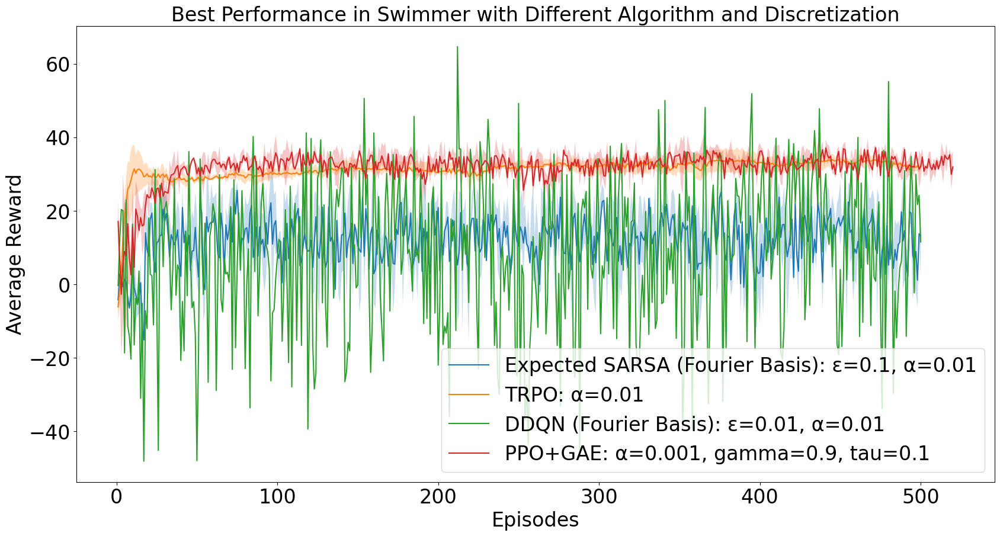

In [336]:
# With best_four_d
plot_summary_performances_v2(best_summary, title='Best Performance in Swimmer with Different Algorithm and Discretization', legend_position='lower right')

In [337]:
cumulative = calculate_overall_metrics(summary)
cumulative

[{'algorithm_name': 'Expected SARSA (Fourier Basis)',
  'alpha': 0.01,
  'epsilon': 0.1,
  'cumulative_rewards': 5973.467492001468,
  'overall_average': 11.946934984002935,
  'overall_std_error': 0.2549852865233704},
 {'algorithm_name': 'TRPO',
  'alpha': 0.01,
  'epsilon': 'N/A',
  'cumulative_rewards': 15637.169401665487,
  'overall_average': 31.274338803330973,
  'overall_std_error': 0.10058818607156515},
 {'algorithm_name': 'DDQN (Fourier Basis)',
  'alpha': 0.01,
  'epsilon': 0.01,
  'cumulative_rewards': 4214.735141158937,
  'overall_average': 8.429470282317874,
  'overall_std_error': 0.9043482583981275},
 {'algorithm_name': 'PPO+GAE',
  'alpha': 0.001,
  'gamma': 0.9,
  'tau': 0.1,
  'cumulative_rewards': 16494.577874682633,
  'overall_average': 31.720342066697373,
  'overall_std_error': 0.13623099659211385}]

| Algorithm Name                 | Alpha | Epsilon | Cumulative Rewards | Overall Average | Overall Std Error |
|--------------------------------|-------|---------|--------------------|-----------------|-------------------|
| Expected SARSA (Fourier Basis) | 0.01  | 0.1     | 5973.467492001468  | 11.946934984002935 | 0.2549852865233704 |
| DDQN (Fourier Basis)           | 0.01  | 0.01    | 4214.735141158937  | 8.429470282317874 | 0.9043482583981275 |
| TRPO                           | 0.01  | N/A     | 15637.169401665487 | 31.274338803330973 | 0.10058818607156515 |
| PPO+GAE                        | 0.01  | N/A     | 16494.577874682633 | 31.720342066697373 | 0.13623099659211385 |
